In [ ]:
#CAS ADS 2024/2025: Final Project

In [ ]:
#Income Modeling Based on Socioeconomic Factors: Applying Machine Learning Algorithms to Registry and Tax Data from the Canton of Lucerne

In [ ]:
# by David von Holzen

In [29]:
#Packete laden

#Datenbearbeitung
import pandas as pd
import pyreadstat as prst
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
from collections import defaultdict

#Kartenherstellung
import geopandas as gpd
import pyproj
from matplotlib import cm
from matplotlib.colors import ListedColormap
from matplotlib import colormaps
from branca.colormap import LinearColormap
import folium

#Machine Learning Modelle
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, SimpleRNN
from tensorflow.keras import Input

In [3]:
#Rohdaten einlesen
df_roh, meta = prst.read_sas7bdat("~/lustat-daten/work/data_i/20_wirtschaftliche_soziale_situation_finerheb/reg_pers_10_24.sas7bdat")

# Vorschau
print(df_roh.head())

     jahr ewr_sex ewr_zivilstand ewr_konfession ewr_natldnr ewr_respermit  \
0  2010.0       1              2            121        8100                 
1  2010.0       1              2            111        8100                 
2  2010.0       1              2            311        8218          0301   
3  2010.0       2              2            121        8100                 
4  2010.0       2              1            811        8100                 

     gwr_gkode    gwr_gkodn  sn_erwerb_p1_p2  rst_alter  
0  2666040.337  1210321.985         103504.0       55.0  
1  2666649.363  1210772.719         102338.0       37.0  
2  2662173.836  1211878.006          50455.0       30.0  
3  2663126.500  1214399.812           1234.0       41.0  
4  2670292.301  1211154.994          78411.0       29.0  


In [4]:
#Verteilung der Aufenthaltsbewilligungen
verteilung = df_roh['ewr_respermit'].value_counts(dropna=False).sort_index()
print(verteilung)

ewr_respermit
          3050703
0102            2
02           2685
0201       192567
0202       110509
03           4572
0301       277647
0302       192425
0401            7
0402            1
0503        17717
07             46
0701          555
070101       5505
070102       3364
070103         13
070104        170
070105          1
0702          121
070201        560
070202        388
070204         14
070205          3
070907         28
0804         4622
0905         3141
1006           28
1107            9
1300          895
Name: count, dtype: int64


In [13]:
#Gesamtzahl im Datensatz prüfen
print(f"Gesamtzahl in df_roh: {len(df_roh):,}")

Gesamtzahl in df_roh: 3,868,298


In [14]:
#Nationalität formatieren
df_roh['ewr_natldnr'] = pd.to_numeric(df_roh['ewr_natldnr'], errors='coerce')

In [15]:
#Nur Ausländer/innen mit Niederlassungsbewilligung C
# Sicherstellen, dass ewr_respermit als string behandelt wird
df_roh['ewr_respermit'] = df_roh['ewr_respermit'].astype(str)

# Logik: Schweizer behalten ODER Ausländer*innen mit Bewilligung '03xx'
df_permit = df_roh[
    (df_roh['ewr_natldnr'] == 8100) |
    ((df_roh['ewr_natldnr'] != 8100) & (df_roh['ewr_respermit'].str.startswith('03')))
]

In [16]:
# Vorschau
print(df_permit.head())

     jahr ewr_sex ewr_zivilstand ewr_konfession  ewr_natldnr ewr_respermit  \
0  2010.0       1              2            121       8100.0                 
1  2010.0       1              2            111       8100.0                 
2  2010.0       1              2            311       8218.0          0301   
3  2010.0       2              2            121       8100.0                 
4  2010.0       2              1            811       8100.0                 

     gwr_gkode    gwr_gkodn  sn_erwerb_p1_p2  rst_alter  
0  2666040.337  1210321.985         103504.0       55.0  
1  2666649.363  1210772.719         102338.0       37.0  
2  2662173.836  1211878.006          50455.0       30.0  
3  2663126.500  1214399.812           1234.0       41.0  
4  2670292.301  1211154.994          78411.0       29.0  


In [17]:
#Gesamtzahl nach Ausschluss der Ausländer/innen ohne C-Ausweis
print(f"Gesamtzahl in df_permit: {len(df_permit):,}")

Gesamtzahl in df_permit: 3,516,178


In [18]:
#Prüfung der Anzahl Ausländer/innen im Datensatz
anzahl_auslaenderinnen_total = df_roh[
    (df_roh['ewr_natldnr'] != 8100)
].shape[0]

print(f"Es sind {anzahl_auslaenderinnen_total:,} Ausländerinnen im Datensatz df_roh enthalten.")

Es sind 826,731 Ausländerinnen im Datensatz df_roh enthalten.


In [19]:
anzahl_auslaenderinnen_c = df_permit[
    (df_permit['ewr_natldnr'] != 8100)
].shape[0]

print(f"Es sind {anzahl_auslaenderinnen_c:,} Ausländerinnen im Datensatz df_permit enthalten.")

Es sind 474,611 Ausländerinnen im Datensatz df_permit enthalten.


In [20]:
# Beschreibende Statistik für numerische Variablen
variablen = ['rst_alter', 'sn_erwerb_p1_p2']

statistik_df = df_permit[variablen].describe().T  # Transponieren für bessere Lesbarkeit

# Anzeigen
print(statistik_df)

                     count          mean           std        min      25%  \
rst_alter        3516178.0     41.738427     13.211023       18.0     30.0   
sn_erwerb_p1_p2  2730106.0  59053.312085  51106.694270 -6149621.0  27745.0   

                     50%      75%        max  
rst_alter           42.0     53.0       64.0  
sn_erwerb_p1_p2  54533.0  76829.0  1998648.0  


In [21]:
#Anzahl Beobachtungen mit negativen Werten
df_negativ = df_permit[df_permit['sn_erwerb_p1_p2'] < 0]
print(f"Anzahl negativer Einkommen: {len(df_negativ)}")

Anzahl negativer Einkommen: 7292


In [22]:
#Anzahl Beobachtungen mit Missings beim Einkommen (2010-2022)
df_na = df_permit[(df_permit['sn_erwerb_p1_p2'].isna()) & (df_roh['jahr'] <= 2022)]
print(f"Anzahl fehlender Werte (bis inkl. 2022): {len(df_na)}")

/tmp/ipykernel_85567/3999584704.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_na = df_permit[(df_permit['sn_erwerb_p1_p2'].isna()) & (df_roh['jahr'] <= 2022)]


Anzahl fehlender Werte (bis inkl. 2022): 307829


In [23]:
#Negative und Missing Werte entfernen (nur für Jahre 2010-2022)
df = df_permit.copy()

# Für Jahre bis einschließlich 2022: Negative und fehlende Werte entfernen
df.loc[df['jahr'] <= 2022, 'sn_erwerb_p1_p2'] = df.loc[df['jahr'] <= 2022, 'sn_erwerb_p1_p2'].where(df['sn_erwerb_p1_p2'] >= 0)

# Danach alle Zeilen entfernen, bei denen sn_erwerb_p1_p2 für Jahre <= 2022 NA ist
df = df[~((df['jahr'] <= 2022) & (df['sn_erwerb_p1_p2'].isna()))].copy()

In [24]:
#Datentypen anpassen
# Jahr, Geschlecht, Zivilstand etc. in numerische Werte umwandeln
df['jahr'] = pd.to_numeric(df['jahr'], errors='coerce').astype('Int64')
df['ewr_sex'] = pd.to_numeric(df['ewr_sex'], errors='coerce').astype('Int64')
df['ewr_zivilstand'] = pd.to_numeric(df['ewr_zivilstand'], errors='coerce').astype('Int64')
df['ewr_konfession'] = pd.to_numeric(df['ewr_konfession'], errors='coerce').astype('Int64')
df['ewr_natldnr'] = pd.to_numeric(df['ewr_natldnr'], errors='coerce').astype('Int64')

# Einkommen und Alter absichern
df['sn_erwerb_p1_p2'] = pd.to_numeric(df['sn_erwerb_p1_p2'], errors='coerce')
df['rst_alter'] = pd.to_numeric(df['rst_alter'], errors='coerce')

In [25]:
#Nur Beobachtungen mit gültigen Gebäudekoordinaten
df = df[df['gwr_gkode'].notna() & df['gwr_gkodn'].notna()]
print(df.head())

   jahr  ewr_sex  ewr_zivilstand  ewr_konfession  ewr_natldnr ewr_respermit  \
0  2010        1               2             121         8100                 
1  2010        1               2             111         8100                 
2  2010        1               2             311         8218          0301   
3  2010        2               2             121         8100                 
4  2010        2               1             811         8100                 

     gwr_gkode    gwr_gkodn  sn_erwerb_p1_p2  rst_alter  
0  2666040.337  1210321.985         103504.0       55.0  
1  2666649.363  1210772.719         102338.0       37.0  
2  2662173.836  1211878.006          50455.0       30.0  
3  2663126.500  1214399.812           1234.0       41.0  
4  2670292.301  1211154.994          78411.0       29.0  


In [ ]:
#Rasterberechnung

In [26]:
# Schritt 1: Personen-ID und Vorbereitung
df = df.copy()
df['person_id'] = df.index
df['personen'] = 1  # Hier sicherstellen, dass die Spalte existiert!

In [27]:
# Funktion zum Raster berechnen
def berechne_raster(df, raster_size):
    df = df.copy()
    df['x_cell'] = (df['gwr_gkode'] // raster_size).astype(int)
    df['y_cell'] = (df['gwr_gkodn'] // raster_size).astype(int)
    df['cell_id'] = df['x_cell'].astype(str) + "_" + df['y_cell'].astype(str)
    df['raster_size'] = raster_size
    return df

In [28]:
def dynamische_rasterung_jahresweise(df, start_raster=250, max_raster=2000, step=250, min_personen=10):
    df_result = pd.DataFrame()
    df_rest = df.copy()
    raster_stufen = list(range(start_raster, max_raster + step, step))

    for raster_size in raster_stufen:
        # Rasterzellen auf dem gesamten Datensatz berechnen (für Konsistenz über Jahre)
        df_raster = berechne_raster(df.copy(), raster_size)

        # Nur Personen aus dem verbleibenden Rest berücksichtigen
        df_raster = df_raster[df_raster['person_id'].isin(df_rest['person_id'])].copy()

        # Personen pro Zelle und Jahr zählen
        personen_pro_jahr = df_raster.groupby(['cell_id', 'jahr'])['personen'].sum().reset_index()
        personen_pro_jahr = personen_pro_jahr.rename(columns={'personen': 'anzahl_personen_jahr'})

        # Zellen finden, die in jedem Jahr >= min_personen haben
        zellen_gueltig = personen_pro_jahr.groupby('cell_id')['anzahl_personen_jahr'].min().reset_index()
        zellen_gueltig = zellen_gueltig[zellen_gueltig['anzahl_personen_jahr'] >= min_personen]['cell_id']

        # Daten für gültige Zellen übernehmen
        df_valid = df_raster[df_raster['cell_id'].isin(zellen_gueltig)].copy()
        df_valid['raster_size'] = raster_size

        # Ergebnis ergänzen
        df_result = pd.concat([df_result, df_valid], axis=0)

        # Nicht zugewiesene Personen identifizieren
        zugewiesene_ids = df_valid['person_id'].unique()
        df_rest = df_rest[~df_rest['person_id'].isin(zugewiesene_ids)].copy()

        if df_rest.empty:
            break

    return df_result

# Beispielhafte Nutzung mit fein abgestuften Rastergrößen
df_adaptiv = dynamische_rasterung_jahresweise(df, start_raster=20, max_raster=2000, step=10, min_personen=10)

In [30]:
#Rastereinteilung anzeigen
print(df_adaptiv['raster_size'].value_counts().sort_index())

raster_size
20      610727
30       88370
40      206489
50      268688
60      258732
         ...  
1960       561
1970       216
1980       231
1990       236
2000       508
Name: count, Length: 189, dtype: int64


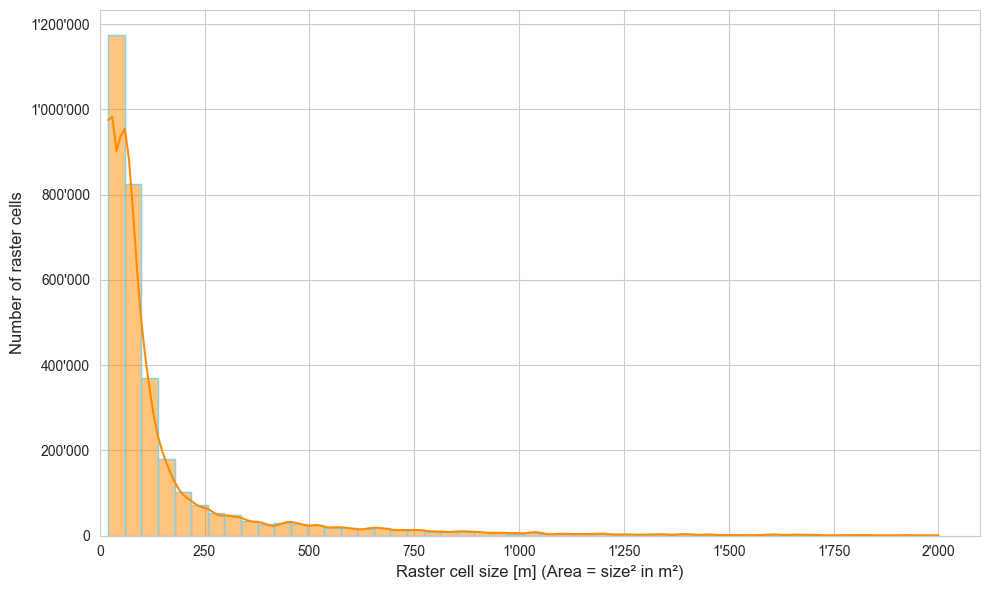

In [31]:
#Grafik für Rastergrösse

# Stil setzen
sns.set_style("whitegrid")

# Funktion für Tausendertrennung
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Plot vorbereiten
fig, ax = plt.subplots(figsize=(10, 6))

# Histogramm zeichnen
sns.histplot(
    data=df_adaptiv,
    x='raster_size',
    bins=50,  # Optional: anpassen je nach Auflösung
    kde=True,
    ax=ax,
    color='darkorange',
    edgecolor='skyblue'
)

# Achsentitel & Formatierung
ax.set_xlabel('Raster cell size [m] (Area = size² in m²)', fontsize=12)
ax.set_ylabel('Number of raster cells', fontsize=12)
ax.yaxis.set_major_formatter(FuncFormatter(format_thousands))
ax.xaxis.set_major_formatter(FuncFormatter(format_thousands))
ax.set_xlim(left=0)  # x-Achse bei 0 starten

# Gitter und Layout
plt.tight_layout()

# Optional: speichern
plt.savefig("verteilung_rastergroessen.png", dpi=300)

plt.show()

In [32]:
# Prüfen
print(df_adaptiv.head())

    jahr  ewr_sex  ewr_zivilstand  ewr_konfession  ewr_natldnr ewr_respermit  \
0   2010        1               2             121         8100                 
9   2010        1               4             811         8252          0302   
10  2010        2               1             711         8100                 
15  2010        2               1             121         8100                 
49  2010        1               1             711         8100                 

      gwr_gkode    gwr_gkodn  sn_erwerb_p1_p2  rst_alter  person_id  personen  \
0   2666040.337  1210321.985         103504.0       55.0          0         1   
9   2666314.034  1207969.212          50491.0       36.0          9         1   
10  2669486.616  1211721.727          38745.0       57.0         10         1   
15  2666189.075  1212042.561          62015.0       23.0         15         1   
49  2662054.842  1211559.353          76252.0       27.0         49         1   

    x_cell  y_cell       cell_id

In [33]:
#Prüfung ob alle Personen zugewiesen werden konnten
anzahl_urspruenglich = df.shape[0]
anzahl_zugewiesen = df_adaptiv.shape[0]

print(f"Alle Personen zugewiesen: {anzahl_urspruenglich == anzahl_zugewiesen}")
print(f"Ursprünglich: {anzahl_urspruenglich}, Zugewiesen: {anzahl_zugewiesen}")

Alle Personen zugewiesen: False
Ursprünglich: 3196150, Zugewiesen: 3172743


In [34]:
#Anzahl/Anteil nicht zugewiesene Personen berechnen

df_rest_ids = df[~df['person_id'].isin(df_adaptiv['person_id'])]

# Anzahl nicht zugewiesener Personen
anzahl_nicht_zugewiesen = df_rest_ids.shape[0]

# Gesamtanzahl Personen im Original
anzahl_gesamt = df.shape[0]

# Anteil berechnen
anteil_nicht_zugewiesen = anzahl_nicht_zugewiesen / anzahl_gesamt

# Ausgabe
print(f"Nicht zugewiesene Personen: {anzahl_nicht_zugewiesen:,}")
print(f"Anteil nicht zugewiesen: {anteil_nicht_zugewiesen:.4%}")

Nicht zugewiesene Personen: 23,407
Anteil nicht zugewiesen: 0.7323%


In [35]:
#Prüfen ob alle Zellen mindestens 10 Personen enthalten
personen_pro_zelle = df_adaptiv.groupby('cell_id')['personen'].sum()
min_personen_pro_zelle = personen_pro_zelle.min()

print(f"Alle Zellen ≥ 10 Personen: {min_personen_pro_zelle >= 10}")
print(f"Kleinste Personenanzahl in einer Zelle: {min_personen_pro_zelle}")

Alle Zellen ≥ 10 Personen: True
Kleinste Personenanzahl in einer Zelle: 10


In [36]:
#Anzahl Zellen pro Jahr angeben
anzahl_zellen_pro_jahr = df_adaptiv.groupby('jahr')['cell_id'].nunique().reset_index()
anzahl_zellen_pro_jahr.columns = ['jahr', 'anzahl_zellen']
print(anzahl_zellen_pro_jahr)

    jahr  anzahl_zellen
0   2010          12050
1   2011          12123
2   2012          12194
3   2013          12251
4   2014          12344
5   2015          12438
6   2016          12506
7   2017          12588
8   2018          12685
9   2019          12748
10  2020          12813
11  2021          12881
12  2022          12957
13  2023          13033
14  2024          13095


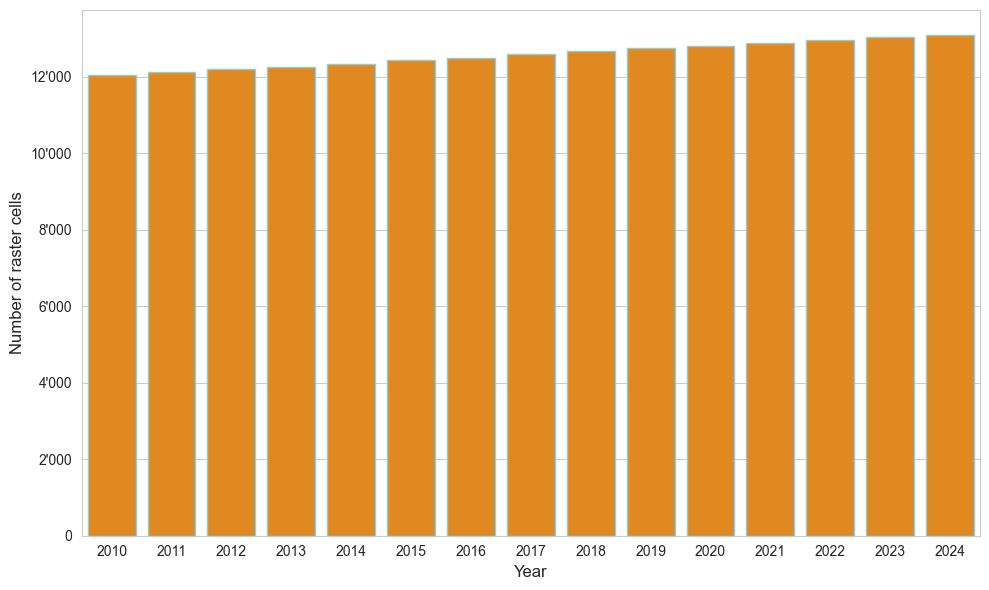

In [37]:
#Grafik für Anzahl Rasterzellen pro Jahr

# Stil setzen
sns.set_style("whitegrid")

# Funktion für Tausendertrennung
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Plot vorbereiten
fig, ax = plt.subplots(figsize=(10, 6))

# Balkendiagramm zeichnen
sns.barplot(
    data=anzahl_zellen_pro_jahr,
    x='jahr',
    y='anzahl_zellen',
    color='darkorange',
    edgecolor='skyblue',
    ax=ax
)

# Achsentitel & Formatierung
ax.set_xlabel('Year', fontsize=12)
ax.set_ylabel('Number of raster cells', fontsize=12)
ax.set_ylim(bottom=0)  # Y-Achse bei 0 starten
ax.yaxis.set_major_formatter(FuncFormatter(format_thousands))

# Layout anpassen
plt.tight_layout()

# Optional speichern
plt.savefig("anzahl_rasterzellen_pro_jahr.png", dpi=300)

plt.show()

In [ ]:
#Räumliche Visualisierung der Rasterzellen

In [38]:
#Mittelpunkte der Koordinaten berechnen
def berechne_mittelpunkt_adaptiv(df):
    df = df.copy()
    df['x_mitte'] = df['x_cell'] * df['raster_size'] + df['raster_size'] / 2
    df['y_mitte'] = df['y_cell'] * df['raster_size'] + df['raster_size'] / 2
    return df

In [39]:
# Nur Daten für 2024 aus df_adaptiv verwenden
df_map = (
    df_adaptiv[df_adaptiv['jahr'] == 2024]
    .groupby(['cell_id', 'x_cell', 'y_cell', 'raster_size'])
    .agg(personen=('personen', 'sum'))
    .reset_index()
)

# Zellmittel berechnen (je nach Rastergröße)
df_map = berechne_mittelpunkt_adaptiv(df_map)

In [40]:
# Farben manuell definieren (z. B. 3-Stufen-Farbskala)
colormap = LinearColormap(
    colors=['#ffffcc', '#41b6c4', '#0c2c84'],
    vmin=df_map['personen'].min(),
    vmax=df_map['personen'].max(),
    caption='Anzahl Personen pro Rasterzelle'
)

In [41]:
#Interakvite Karte mti Zellgrössen

# Koordinaten in WGS84 umrechnen (CH1903 zu Lat/Lon) falls nötig
def ch1903_to_wgs84(e, n):
    import pyproj
    transformer = pyproj.Transformer.from_crs("EPSG:2056", "EPSG:4326", always_xy=True)
    return transformer.transform(e, n)

# Neue Spalten mit Lat/Lon
df_map[['lon', 'lat']] = df_map.apply(lambda row: pd.Series(ch1903_to_wgs84(row['x_mitte'], row['y_mitte'])), axis=1)

# Karte zentrieren (auf Schweiz z. B.)
map_center = [df_map['lat'].mean(), df_map['lon'].mean()]
m = folium.Map(location=map_center, zoom_start=9, tiles='cartodbpositron')

# Punkte einfügen
for _, row in df_map.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['lon']],
        radius=5,
        color=colormap(row['personen']),
        fill=True,
        fill_opacity=0.7,
        popup=f"Zelle: {row['cell_id']}<br>Anz. Personen: {row['personen']}"
    ).add_to(m)

colormap.caption = 'Anzahl Personen pro Rasterzelle'
colormap.add_to(m)

In [42]:
#Anzeigen
m

In [43]:
# Kanton Luzern aus GeoJSON extrahieren
kantone = gpd.read_file("~/lustat-daten/work/data_i/20_wirtschaftliche_soziale_situation_finerheb/kantonsgrenzen.shp")
luzern = kantone[kantone['NAME'] == 'Luzern']

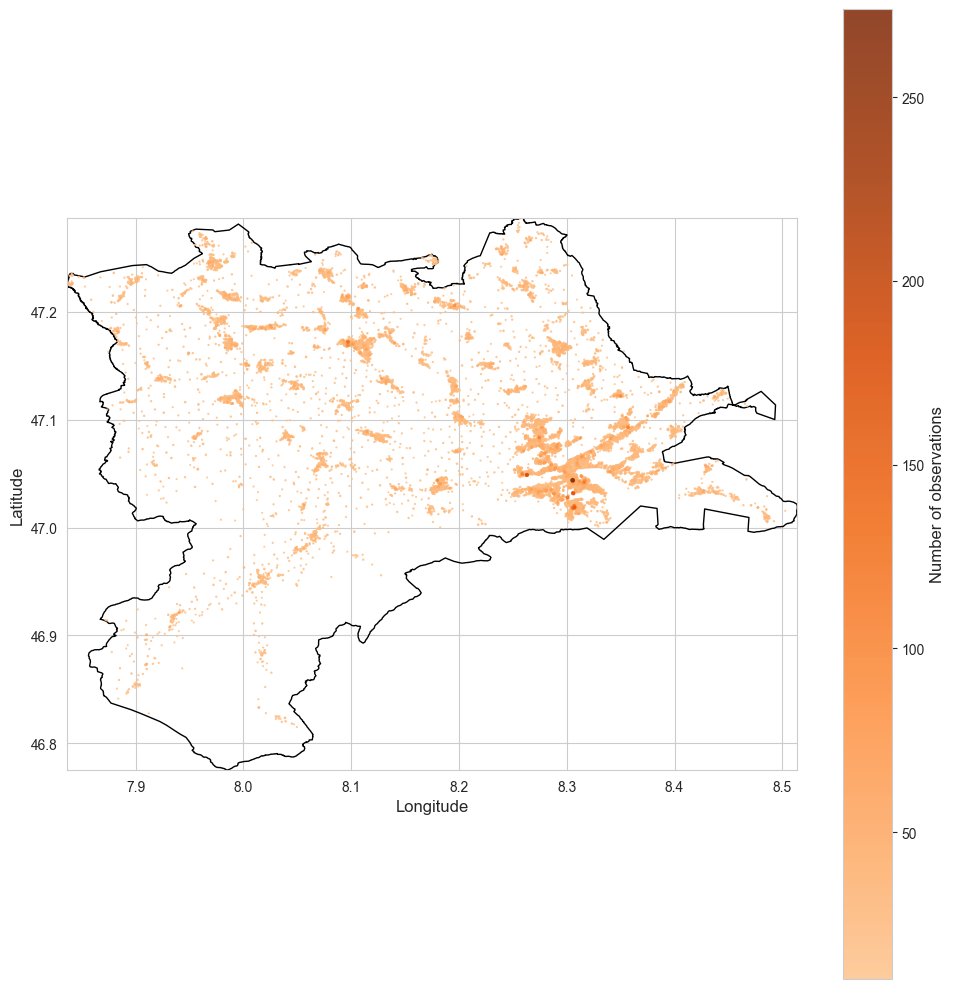

In [44]:
#Grafik mit räumlicher Verteilung der Rasterzellen im Kanton Luzern

# ----------------------------
# 1. Umrechnung in WGS84 (falls lon/lat fehlen)
# ----------------------------
def ch1903_to_wgs84(e, n):
    transformer = pyproj.Transformer.from_crs("EPSG:2056", "EPSG:4326", always_xy=True)
    return transformer.transform(e, n)

if 'lon' not in df_map.columns or 'lat' not in df_map.columns:
    df_map[['lon', 'lat']] = df_map.apply(
        lambda row: pd.Series(ch1903_to_wgs84(row['x_mitte'], row['y_mitte'])),
        axis=1
    )

# ----------------------------
# 2. Kantonsgrenze Luzern laden & projizieren
# ----------------------------
kantone = gpd.read_file("~/lustat-daten/work/data_i/20_wirtschaftliche_soziale_situation_finerheb/kantonsgrenzen.shp")
luzern = kantone[kantone['NAME'] == 'Luzern'].copy().to_crs("EPSG:4326")

# ----------------------------
# 3. Punktgröße berechnen & sortieren
# ----------------------------
df_map['size'] = (df_map['personen'] ** 0.5) * 0.7
df_map_sorted = df_map.sort_values('personen')

# ----------------------------
# 4. Farbpalette trimmen (Oranges von 0.3 bis 1.0)
# ----------------------------
cmap_oranges = colormaps['Oranges']  # zukunftssicherer Zugriff
cmap_trimmed = ListedColormap(cmap_oranges(np.linspace(0.3, 1, 256)))

# ----------------------------
# 5. Plot
# ----------------------------
fig, ax = plt.subplots(figsize=(10, 10))

# Kantonsgrenze
luzern.plot(ax=ax, edgecolor='black', facecolor='none', linewidth=1)

# Punkte plotten mit getrimmter Farbpalette
sc = ax.scatter(
    df_map_sorted['lon'], df_map_sorted['lat'],
    c=df_map_sorted['personen'],
    s=df_map_sorted['size'],
    cmap=cmap_trimmed,
    alpha=0.85,
    edgecolor='none',
    linewidth=0.3
)

# Farbleiste
cbar = plt.colorbar(sc, ax=ax)
cbar.set_label('Number of observations', fontsize=12)

# Kartenausschnitt & Format
bounds = luzern.total_bounds
ax.set_xlim(bounds[0], bounds[2])
ax.set_ylim(bounds[1], bounds[3])
ax.set_aspect('equal')

# Achsen optional entfernen für cleanes Layout
ax.set_xlabel('Longitude', fontsize=12)
ax.set_ylabel('Latitude', fontsize=12)

plt.tight_layout()
plt.savefig("personenkarte_luzern_2024.png", dpi=300)
plt.show()

In [ ]:
#Datensatz auf Zellebene aggregieren

In [45]:
# Aggregation nach cell_id (pro Rasterzelle)
df_aggregiert = df_adaptiv.groupby(['cell_id', 'jahr']).agg(
    durchschnitt_alter=('rst_alter', 'mean'),
    durchschnitt_einkommen=('sn_erwerb_p1_p2', 'median'),

    # Alle Anteilsvariablen
    anteil_frauen=('ewr_sex', lambda x: (x == 2).mean()),
    anteil_verheiratet=('ewr_zivilstand', lambda x: (x == 2).mean()),
    anteil_ev_ref=('ewr_konfession', lambda x: (x == 111).mean()),
    anteil_auslaender=('ewr_natldnr', lambda x: (x != 8100).mean()),

    anzahl_personen=('personen', 'sum'),
    raster_size=('raster_size', 'first'),
    x_cell=('x_cell', 'first'),
    y_cell=('y_cell', 'first')
).reset_index()

In [46]:
print(df_aggregiert.head())

      cell_id  jahr  durchschnitt_alter  durchschnitt_einkommen  \
0  10116_4736  2010           43.320000                 41729.0   
1  10116_4736  2011           42.800000                 40176.0   
2  10116_4736  2012           41.409091                 47133.5   
3  10116_4736  2013           43.130435                 45905.0   
4  10116_4736  2014           43.772727                 51913.5   

   anteil_frauen  anteil_verheiratet  anteil_ev_ref  anteil_auslaender  \
0       0.520000            0.600000       0.240000           0.040000   
1       0.560000            0.600000       0.280000           0.040000   
2       0.545455            0.590909       0.227273           0.045455   
3       0.521739            0.608696       0.130435           0.043478   
4       0.545455            0.590909       0.181818           0.045455   

   anzahl_personen  raster_size  x_cell  y_cell  
0               25          260   10116    4736  
1               25          260   10116    4736  
2 

In [47]:
# Beschreibende Statistik für alle Variablen
variablen = [
    'jahr','durchschnitt_alter', 'durchschnitt_einkommen', 'anteil_frauen',
    'anteil_verheiratet', 'anteil_ev_ref', 'anteil_auslaender'
]

statistik_df = df_aggregiert[variablen].describe().T  # Transponieren für bessere Lesbarkeit

# Anzeigen
print(statistik_df)

                           count          mean          std        min  \
jahr                    188706.0   2017.112959     4.318074     2010.0   
durchschnitt_alter      188706.0      41.65704     4.281457  24.153846   
durchschnitt_einkommen  162578.0  54801.840766  13855.85225     3608.0   
anteil_frauen           188706.0      0.477204     0.092485        0.0   
anteil_verheiratet      188706.0      0.512456     0.190675        0.0   
anteil_ev_ref           188706.0      0.101456     0.098528        0.0   
anteil_auslaender       188706.0      0.120353     0.149409        0.0   

                              25%        50%       75%        max  
jahr                       2013.0     2017.0    2021.0     2024.0  
durchschnitt_alter      38.782609  41.636364      44.5  60.181818  
durchschnitt_einkommen   46237.25    54224.0  62570.75   192409.0  
anteil_frauen            0.416667   0.473684  0.538462   0.928571  
anteil_verheiratet       0.384615   0.526316  0.642857        1.0  

In [49]:
#Variablenverteilung als Latex-Tabelle aufbereiten

# Statistik berechnen und transponieren
statistik_df = df_aggregiert[variablen].describe().T

# Runden (optional, z. B. auf 2 Dezimalstellen)
statistik_df = statistik_df.round(2)

# Spalten ggf. umbenennen für LaTeX
statistik_df.columns = [
    'Count', 'Mean', 'Std.-dev.', 'Min',
    '25\%', 'Median', '75\%', 'Max'
]

# Ausgabe als LaTeX-Tabelle
latex_code = statistik_df.to_latex(
    caption="Descriptive statistics of the aggregated variables",
    label="tab:deskriptiv",
    index=True,
    header=True,
    column_format="lrrrrrrrr",
    escape=False
)

print(latex_code)

\begin{table}
\caption{Descriptive statistics of the aggregated variables}
\label{tab:deskriptiv}
\begin{tabular}{lrrrrrrrr}
\toprule
 & Count & Mean & Std.-dev. & Min & 25\% & Median & 75\% & Max \\
\midrule
jahr & 188706.000000 & 2017.112959 & 4.318074 & 2010.000000 & 2013.000000 & 2017.000000 & 2021.000000 & 2024.000000 \\
durchschnitt_alter & 188706.000000 & 41.657040 & 4.281457 & 24.153846 & 38.782609 & 41.636364 & 44.500000 & 60.181818 \\
durchschnitt_einkommen & 162578.000000 & 54801.840766 & 13855.852250 & 3608.000000 & 46237.250000 & 54224.000000 & 62570.750000 & 192409.000000 \\
anteil_frauen & 188706.000000 & 0.477204 & 0.092485 & 0.000000 & 0.416667 & 0.473684 & 0.538462 & 0.928571 \\
anteil_verheiratet & 188706.000000 & 0.512456 & 0.190675 & 0.000000 & 0.384615 & 0.526316 & 0.642857 & 1.000000 \\
anteil_ev_ref & 188706.000000 & 0.101456 & 0.098528 & 0.000000 & 0.000000 & 0.076923 & 0.153846 & 0.933333 \\
anteil_auslaender & 188706.000000 & 0.120353 & 0.149409 & 0.000000 & 

<>:12: SyntaxWarning: invalid escape sequence '\%'
<>:12: SyntaxWarning: invalid escape sequence '\%'
<>:12: SyntaxWarning: invalid escape sequence '\%'
<>:12: SyntaxWarning: invalid escape sequence '\%'
/tmp/ipykernel_85567/1571600597.py:12: SyntaxWarning: invalid escape sequence '\%'
  '25\%', 'Median', '75\%', 'Max'
/tmp/ipykernel_85567/1571600597.py:12: SyntaxWarning: invalid escape sequence '\%'
  '25\%', 'Median', '75\%', 'Max'


In [ ]:
#Zielvariable für Analyse vorbereiten

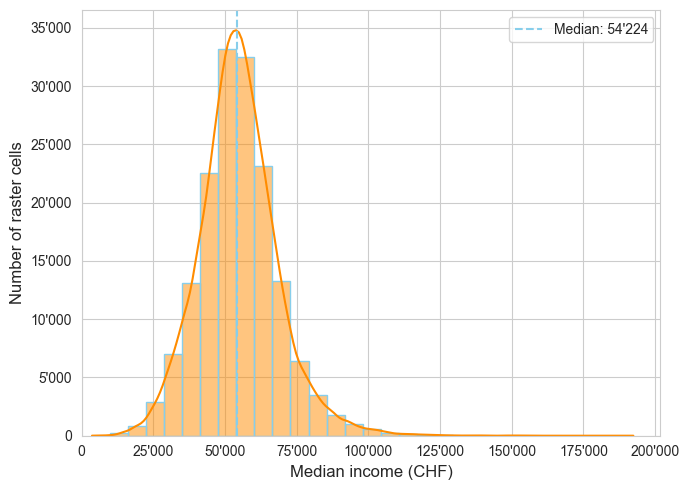

In [50]:
#Grafik mit Einkommensverteilung

sns.set_style("whitegrid")

# Formatierungsfunktion mit Hochkomma als Trennzeichen
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Plot
plt.figure(figsize=(7, 5))
ax = sns.histplot(
    data=df_aggregiert,
    x='durchschnitt_einkommen',
    bins=30,
    kde=True,
    color='darkorange',
    edgecolor='skyblue'
)

# Mittelwertlinie
median_val = df_aggregiert['durchschnitt_einkommen'].median()
plt.axvline(median_val, color='skyblue', linestyle='--', linewidth=1.5, label=f"Median: {median_val:,.0f}".replace(",", "'"))

# Achsen formatieren
ax.xaxis.set_major_formatter(FuncFormatter(format_thousands))
ax.yaxis.set_major_formatter(FuncFormatter(format_thousands))
ax.set_xlim(left=0)  # x-Achse bei 0 starten

# Achsentitel und Legende
plt.xlabel('Median income (CHF)', fontsize=12)
plt.ylabel('Number of raster cells', fontsize=12)
plt.legend()
plt.tight_layout()
plt.savefig("verteilung_einkommen.png", dpi=300)
plt.show()

In [51]:
#Oberstes Einkommensperzentil ausschliessen
q99 = df_aggregiert['durchschnitt_einkommen'].quantile(0.99)
df_aggregiert_eink = df_aggregiert[
    (df_aggregiert['durchschnitt_einkommen'] <= q99) |
    (df_aggregiert['durchschnitt_einkommen'].isna())
]

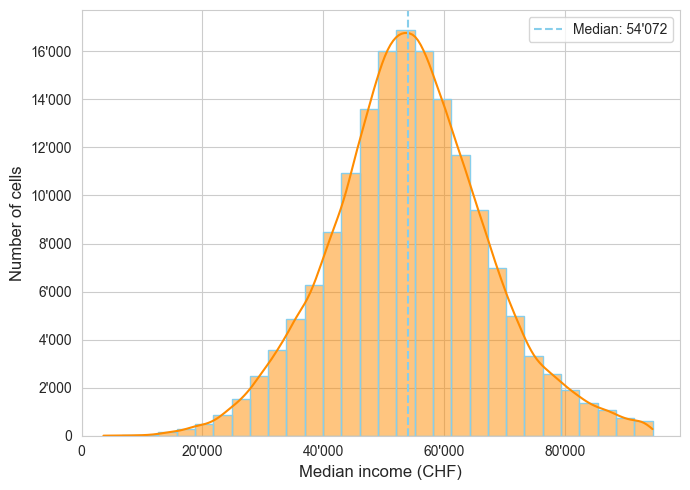

In [52]:
#Grafik mit Einkommensverteilung nach Ausschluss 100. Perzentil

# Plot
plt.figure(figsize=(7, 5))
ax = sns.histplot(
    data=df_aggregiert_eink,
    x='durchschnitt_einkommen',
    bins=30,
    kde=True,
    color='darkorange',
    edgecolor='skyblue'
)

# Mittelwertlinie
median_val = df_aggregiert_eink['durchschnitt_einkommen'].median()
plt.axvline(median_val, color='skyblue', linestyle='--', linewidth=1.5, label=f"Median: {median_val:,.0f}".replace(",", "'"))

# Achsen formatieren
ax.xaxis.set_major_formatter(FuncFormatter(format_thousands))
ax.yaxis.set_major_formatter(FuncFormatter(format_thousands))
ax.set_xlim(left=0)  # x-Achse bei 0 starten

# Achsentitel und Legende
plt.xlabel('Median income (CHF)', fontsize=12)
plt.ylabel('Number of cells', fontsize=12)
plt.legend()
plt.tight_layout()
plt.savefig("verteilung_einkommen_p90.png", dpi=300)
plt.show()

In [53]:
#Analysedatensatz herstellen
df_analyse = df_aggregiert_eink[["cell_id","jahr", "durchschnitt_alter","durchschnitt_einkommen","anteil_frauen","anteil_verheiratet","anteil_ev_ref","anteil_auslaender"]].copy()       

In [54]:
#Analysedatensatz anzeigen
print(df_analyse.head())

      cell_id  jahr  durchschnitt_alter  durchschnitt_einkommen  \
0  10116_4736  2010           43.320000                 41729.0   
1  10116_4736  2011           42.800000                 40176.0   
2  10116_4736  2012           41.409091                 47133.5   
3  10116_4736  2013           43.130435                 45905.0   
4  10116_4736  2014           43.772727                 51913.5   

   anteil_frauen  anteil_verheiratet  anteil_ev_ref  anteil_auslaender  
0       0.520000            0.600000       0.240000           0.040000  
1       0.560000            0.600000       0.280000           0.040000  
2       0.545455            0.590909       0.227273           0.045455  
3       0.521739            0.608696       0.130435           0.043478  
4       0.545455            0.590909       0.181818           0.045455  


In [55]:
#1. Durchschnitt und Veränderung berechnen
df_real = df_analyse[df_analyse['jahr'] <= 2022]
df_avg = df_real.groupby('jahr')['durchschnitt_einkommen'].mean().reset_index()
df_avg['veränderung'] = df_avg['durchschnitt_einkommen'].diff()

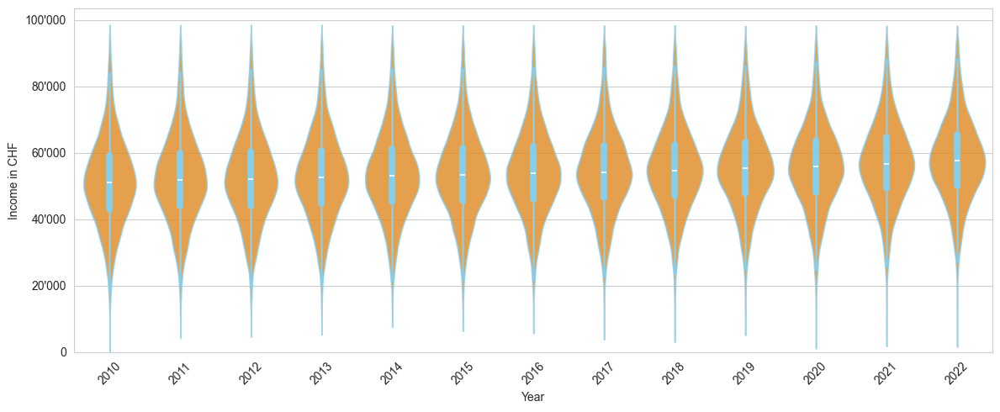

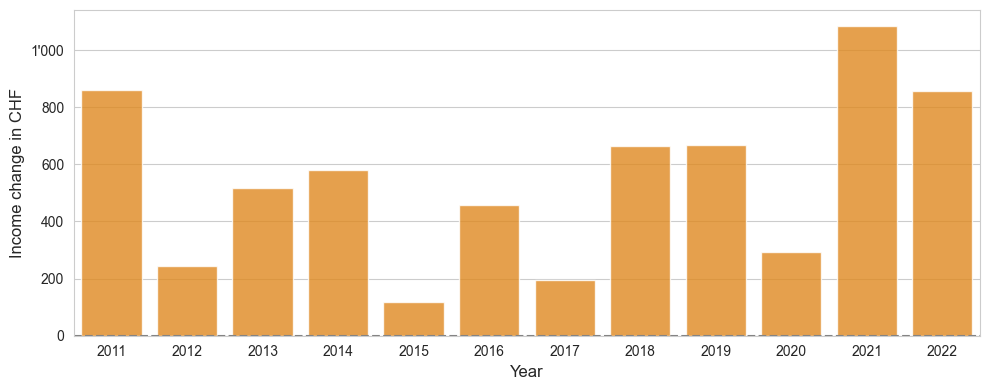

In [56]:
#Grafik mit Einkommensverteilung von 2010 bis 2022 und Veränderungen gegenüber Vorjahr

sns.set_style("whitegrid")

# Tausendertrennzeichen
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# 1. Violinplot: Einkommen pro Jahr
plt.figure(figsize=(12, 5))
ax1 = sns.violinplot(
    data=df_real,
    x='jahr',
    y='durchschnitt_einkommen',
    inner='box',              # zeigt zusätzlich den Boxplot im Violinplot
    color='darkorange',
    edgecolor='skyblue',
    alpha=0.8
)

plt.xlabel('Year')
plt.ylabel('Income in CHF')
plt.ylim(0)
plt.xticks(rotation=45)
ax1.yaxis.set_major_formatter(FuncFormatter(format_thousands))
plt.tight_layout()
plt.savefig("verteilung_einkommen_jahr.png", dpi=300)
plt.show()

# 2. Balken Veränderung
plt.figure(figsize=(10, 4))
sns.barplot(data=df_avg[1:], x='jahr', y='veränderung', color='darkorange', alpha=0.8)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Income change in CHF', fontsize=12)
plt.axhline(0, color='grey', linestyle='--')
plt.gca().yaxis.set_major_formatter(FuncFormatter(format_thousands))
plt.tight_layout()
plt.savefig("veränderung_einkommen.png", dpi=300)
plt.show()

In [ ]:
#Features für die Analyse vorbereiten

In [57]:
#Datensatz 2022 erstellen für Featureverteilung
df_2022 = df_real[df_real['jahr'] == 2022]

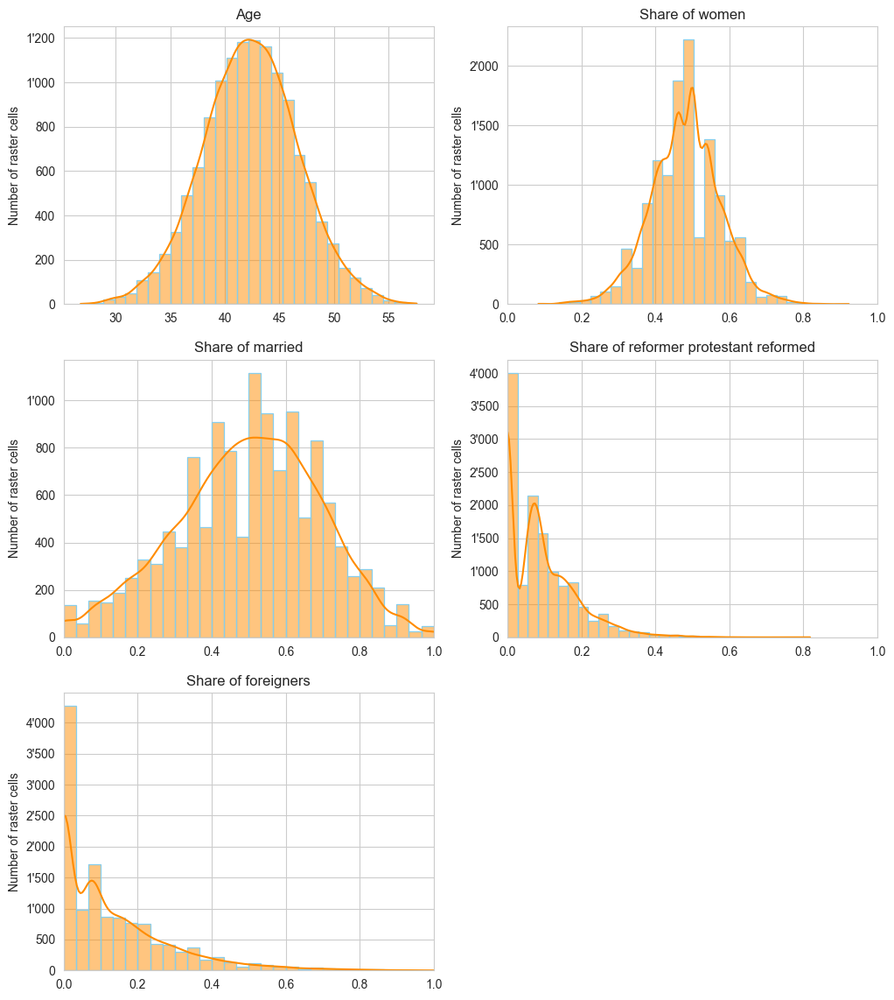

In [58]:
#Grafik mit Verteilung der Features

# Stil setzen
sns.set_style("whitegrid")

# Variablen & Titel
variablen = ['durchschnitt_alter', 'anteil_frauen', 'anteil_verheiratet', 'anteil_ev_ref', 'anteil_auslaender']
titel = ['Age', 'Share of women', 'Share of married', 'Share of reformer protestant reformed', 'Share of foreigners']

# Tausendertrennzeichen
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Subplots vorbereiten: 3 Reihen × 2 Spalten
fig, axs = plt.subplots(3, 2, figsize=(12, 14))  # Mehr Höhe für bessere Lesbarkeit

for i, (var, title) in enumerate(zip(variablen, titel)):
    ax = axs[i // 2, i % 2]  # Position im Raster

    sns.histplot(
        data=df_2022,
        x=var,
        bins=30,
        kde=True,
        ax=ax,
        color='darkorange',
        edgecolor='skyblue'
    )

    ax.set_title(f'{title}', fontsize=12)
    ax.set_xlabel('')
    ax.set_ylabel('Number of raster cells')
    ax.yaxis.set_major_formatter(FuncFormatter(format_thousands))

    if var.startswith('anteil_'):
        ax.set_xlim(0, 1)

# Leeres Feld (unten rechts) ausblenden
axs[2, 1].axis('off')

# Speichern & anzeigen
plt.savefig("verteilung_features.png", dpi=300)
plt.show()

In [ ]:
#Features and Target Variables

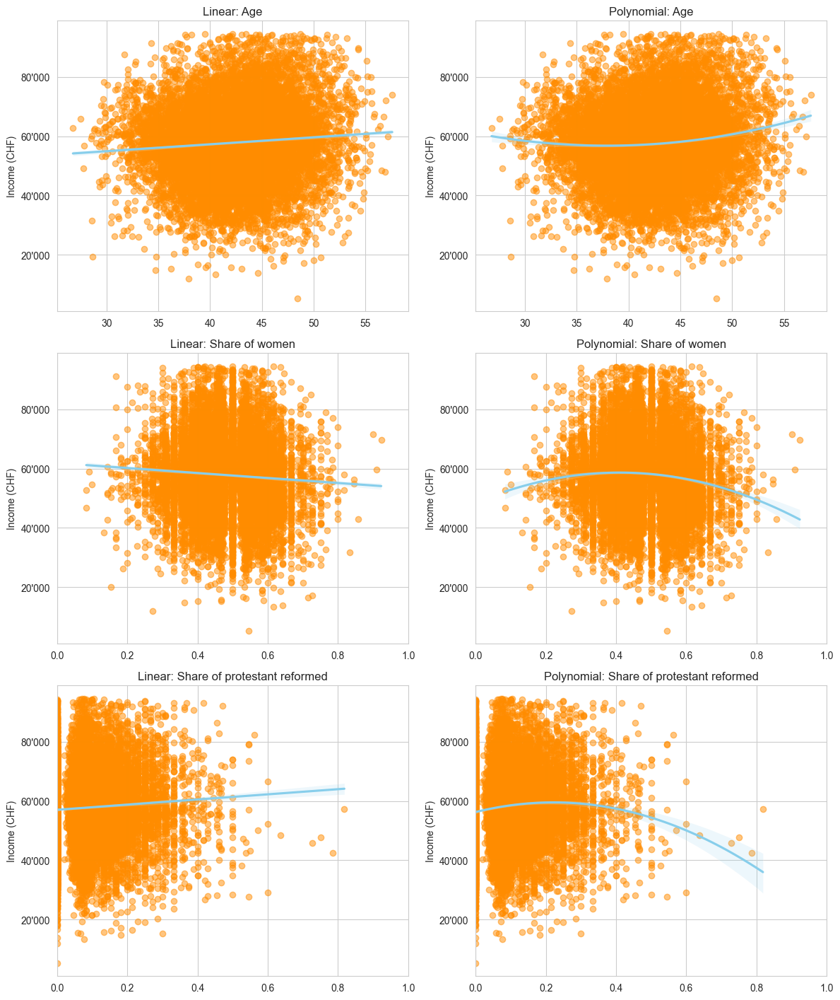

In [59]:
#Grafik mit Zusammenhang der Features und Target (Teil 1)

# Erste drei Variablen
features1 = ['durchschnitt_alter', 'anteil_frauen', 'anteil_ev_ref']
titles1 = ['Age', 'Share of women', 'Share of protestant reformed']

fig, axs = plt.subplots(len(features1), 2, figsize=(12, 15))  # 3 Zeilen, 2 Spalten

for i, (feat, title) in enumerate(zip(features1, titles1)):
    ax1 = axs[i, 0]
    sns.regplot(
        data=df_2022, x=feat, y='durchschnitt_einkommen',
        ax=ax1,
        scatter_kws={'alpha': 0.5, 'color': 'darkorange'},
        line_kws={'color': 'skyblue'}
    )
    ax1.set_title(f'Linear: {title}')
    ax1.set_xlabel('')
    ax1.set_ylabel('Income (CHF)')
    ax1.yaxis.set_major_formatter(FuncFormatter(format_thousands))
    if feat.startswith('anteil_'): ax1.set_xlim(0, 1)

    ax2 = axs[i, 1]
    sns.regplot(
        data=df_2022, x=feat, y='durchschnitt_einkommen',
        order=2,
        ax=ax2,
        scatter_kws={'alpha': 0.5, 'color': 'darkorange'},
        line_kws={'color': 'skyblue'}
    )
    ax2.set_title(f'Polynomial: {title}')
    ax2.set_xlabel('')
    ax2.set_ylabel('Income (CHF)')
    ax2.yaxis.set_major_formatter(FuncFormatter(format_thousands))
    if feat.startswith('anteil_'): ax2.set_xlim(0, 1)

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.savefig("zusammenhang_einkommen_features_1.png", dpi=300)
plt.show()

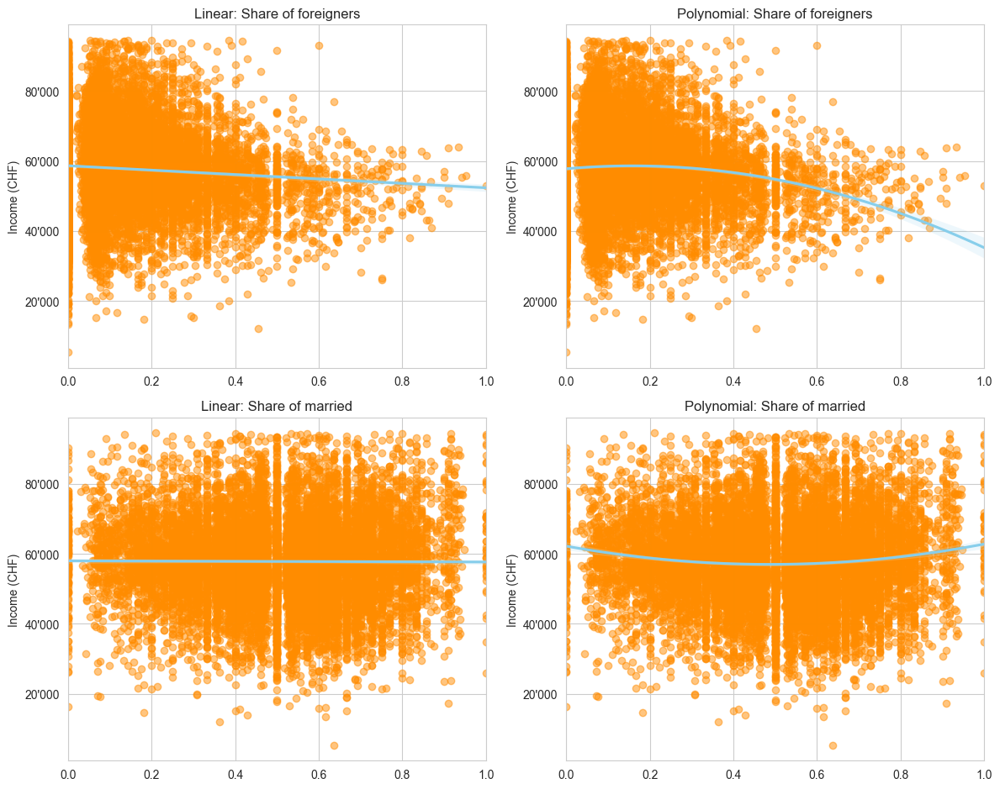

In [60]:
#Grafik mit Zusammenhang der Features und Target (Teil 2)

# Letzte zwei Variablen
features2 = ['anteil_auslaender', 'anteil_verheiratet']
titles2 = ['Share of foreigners', 'Share of married']

fig, axs = plt.subplots(len(features2), 2, figsize=(12, 10))  # 2 Zeilen, 2 Spalten

for i, (feat, title) in enumerate(zip(features2, titles2)):
    ax1 = axs[i, 0]
    sns.regplot(
        data=df_2022, x=feat, y='durchschnitt_einkommen',
        ax=ax1,
        scatter_kws={'alpha': 0.5, 'color': 'darkorange'},
        line_kws={'color': 'skyblue'}
    )
    ax1.set_title(f'Linear: {title}')
    ax1.set_xlabel('')
    ax1.set_ylabel('Income (CHF)')
    ax1.yaxis.set_major_formatter(FuncFormatter(format_thousands))
    if feat.startswith('anteil_'): ax1.set_xlim(0, 1)

    ax2 = axs[i, 1]
    sns.regplot(
        data=df_2022, x=feat, y='durchschnitt_einkommen',
        order=2,
        ax=ax2,
        scatter_kws={'alpha': 0.5, 'color': 'darkorange'},
        line_kws={'color': 'skyblue'}
    )
    ax2.set_title(f'Polynomial: {title}')
    ax2.set_xlabel('')
    ax2.set_ylabel('Income (CHF)')
    ax2.yaxis.set_major_formatter(FuncFormatter(format_thousands))
    if feat.startswith('anteil_'): ax2.set_xlim(0, 1)

plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.savefig("zusammenhang_einkommen_features_2.png", dpi=300)
plt.show()

In [ ]:
#Machine Learning Modelle

In [61]:
# Feature-Sets
features_all = [
    #"jahr",
    "durchschnitt_alter", "anteil_frauen", "anteil_verheiratet",
    "anteil_ev_ref", "anteil_auslaender"
]

features_rnn = [
    "durchschnitt_alter", "anteil_frauen", "anteil_verheiratet",
    "anteil_ev_ref", "anteil_auslaender"
]

target = "durchschnitt_einkommen"

In [ ]:
#Modelle trainieren

In [62]:
# Trainingsdaten (2010–2021)
df_train = df_analyse[df_analyse['jahr'] <= 2021].dropna()
X_train_classic = df_train[features_all]
y_train_classic = df_train[target]

# Modelle trainieren
lr = LinearRegression().fit(X_train_classic, y_train_classic)
rf = RandomForestRegressor(random_state=0).fit(X_train_classic, y_train_classic)
xgb = XGBRegressor(random_state=0).fit(X_train_classic, y_train_classic)

# Testdaten für 2022 (auf Zellebene)
df_test = df_analyse[df_analyse['jahr'] == 2022].dropna()
X_test_classic = df_test[features_all]
y_test = df_test[target].values

# Klassische Modellvorhersagen
y_pred_lr = lr.predict(X_test_classic)
y_pred_rf = rf.predict(X_test_classic)
y_pred_xgb = xgb.predict(X_test_classic)

In [ ]:
# ---------------------------------------------
# RNN-Modell: Rolling Window über Zellverläufe
# ---------------------------------------------

In [63]:
#Prüfen wie viele Zellen in allen Jahren vorkommen
start_year = 2010
end_year = 2022

results_forward = []

for span in range(1, end_year - start_year + 2):
    years = list(range(start_year, start_year + span))
    valid_cells = (
        df_analyse[df_analyse['jahr'].isin(years)]
        .groupby('cell_id')['jahr']
        .agg(set)
        .loc[lambda s: s.apply(lambda x: set(years).issubset(x))]  # alle Jahre müssen enthalten sein
    )
    results_forward.append({'Jahre': f"{years[0]}–{years[-1]}", 'Zellen': len(valid_cells)})

df_forward_check = pd.DataFrame(results_forward)
print(df_forward_check)

        Jahre  Zellen
0   2010–2010   11951
1   2010–2011   11896
2   2010–2012   11857
3   2010–2013   11817
4   2010–2014   11787
5   2010–2015   11736
6   2010–2016   11700
7   2010–2017   11677
8   2010–2018   11646
9   2010–2019   11610
10  2010–2020   11577
11  2010–2021   11524
12  2010–2022   11484


In [64]:
#RNN-Modell aufsetzen

def train_rnn_flexible(df_analyse, features_rnn, target, sequence_length=10, target_year=2022):
    # 1. Nur relevante Jahre
    jahre_needed = list(range(target_year - sequence_length, target_year + 1))
    df = df_analyse[df_analyse['jahr'].isin(jahre_needed)].copy()

    # 2. Zellen mit vollständiger Sequenz + Zieljahr
    valid_cells = (
        df.groupby('cell_id')['jahr']
        .agg(set)
        .loc[lambda s: s.apply(lambda x: set(jahre_needed).issubset(x))]
        .index
    )
    df = df[df['cell_id'].isin(valid_cells)].copy()

    # 3. Skalierer vorbereiten
    scaler_X = MinMaxScaler()
    scaler_y = MinMaxScaler()
    scaler_X.fit(df[features_rnn].values)
    scaler_y.fit(df[[target]].values)

    # 4. Eingabesequenzen und Zielwerte bauen
    X_list, y_list = [], []
    for cell_id in valid_cells:
        df_cell = df[df['cell_id'] == cell_id].sort_values('jahr')
        X_seq = df_cell[df_cell['jahr'] < target_year][features_rnn].values
        y_val = df_cell[df_cell['jahr'] == target_year][target].values[0]

        if X_seq.shape[0] != sequence_length:
            continue

        X_scaled = scaler_X.transform(X_seq)
        y_scaled = scaler_y.transform([[y_val]])

        X_list.append(X_scaled)
        y_list.append(y_scaled[0][0])

    # 5. Arrays erzeugen
    X_rnn = np.array(X_list)
    y_rnn = np.array(y_list)

    if len(X_rnn) == 0:
        print("⚠️ Keine gültigen RNN-Sequenzen gefunden.")
        return None, None, None, None

    # 6. Modell definieren – SimpleRNN anstelle von GRU
    model = Sequential([
        Input(shape=(sequence_length, len(features_rnn))),
        SimpleRNN(64, activation='tanh'),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse')
    model.fit(X_rnn, y_rnn, epochs=50, verbose=0)

    # 7. Prognose und Bewertung
    y_pred_scaled = model.predict(X_rnn)
    y_pred = scaler_y.inverse_transform(y_pred_scaled)
    y_true = scaler_y.inverse_transform(y_rnn.reshape(-1, 1))

    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))

    print(f"✅ SimpleRNN-Modellgüte ({target_year}): MAE = {mae:.2f}, RMSE = {rmse:.2f}")

    return model, y_true.flatten(), y_pred.flatten(), valid_cells, X_rnn, y_rnn, scaler_X, scaler_y

In [65]:
#Modell kompillieren
model_rnn, y_true_rnn, y_pred_rnn, cells_rnn, X_rnn, y_rnn, scaler_X_rnn, scaler_y_rnn = train_rnn_flexible(
    df_analyse=df_analyse,
    features_rnn=features_rnn,
    target=target,
    sequence_length=10,
    target_year=2022
)

2025-06-13 12:52:48.135607: E external/local_xla/xla/stream_executor/cuda/cuda_platform.cc:51] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


365/365 ━━━━━━━━━━━━━━━━━━━━ 0s 908us/step
✅ SimpleRNN-Modellgüte (2022): MAE = 9002.08, RMSE = 11572.57


In [67]:
#Perfomance measures berechnen
df_scores = pd.DataFrame({
    'Modell': ['RNN', 'LR', 'RF', 'XGB'],
    'MAE': [
        mean_absolute_error(y_true_rnn, y_pred_rnn),
        mean_absolute_error(y_test, y_pred_lr),
        mean_absolute_error(y_test, y_pred_rf),
        mean_absolute_error(y_test, y_pred_xgb)
    ],
    'RMSE': [
        np.sqrt(mean_squared_error(y_true_rnn, y_pred_rnn)),
        np.sqrt(mean_squared_error(y_test, y_pred_lr)),
        np.sqrt(mean_squared_error(y_test, y_pred_rf)),
        np.sqrt(mean_squared_error(y_test, y_pred_xgb))
    ]
})
print(df_scores)

  Modell           MAE          RMSE
0    RNN   9002.080997  11572.568922
1     LR  10007.954574  12813.048421
2     RF  10315.493122  13230.283866
3    XGB   9819.250654  12562.189719


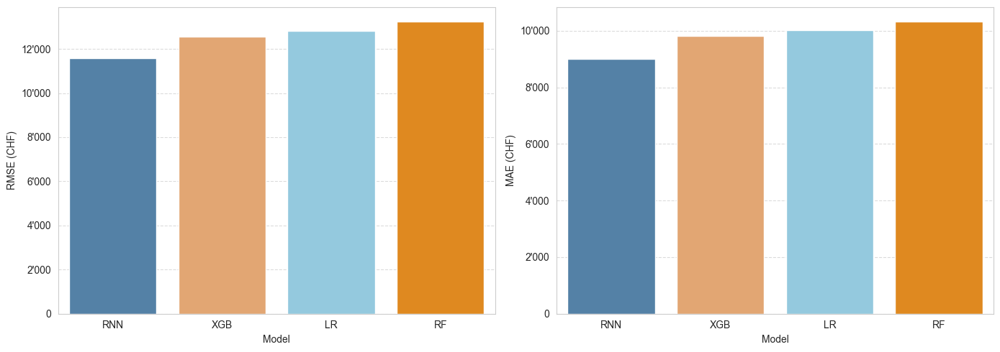

In [68]:
#Grafik mit RMSE und MAE

# Formatierer für Tausendertrennung mit '
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Stil & Farben
sns.set_style("whitegrid")
farben = {
    'RF': '#ff8c00',
    'LR': '#87ceeb',
    'XGB': '#f4a460',
    'RNN': '#4682b4'
}

# Figure mit zwei Subplots nebeneinander
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5), sharey=False)

# RMSE-Plot
sns.barplot(data=df_scores.sort_values('RMSE'),
            x='Modell', y='RMSE', hue='Modell',
            palette=farben, legend=False, ax=ax1)
ax1.set_xlabel("Model")
ax1.set_ylabel("RMSE (CHF)")
ax1.yaxis.set_major_formatter(FuncFormatter(format_thousands))
ax1.set_ylim(bottom=0)
ax1.grid(True, axis='y', linestyle='--', alpha=0.7)

# MAE-Plot
sns.barplot(data=df_scores.sort_values('MAE'),
            x='Modell', y='MAE', hue='Modell',
            palette=farben, legend=False, ax=ax2)
ax2.set_xlabel("Model")
ax2.set_ylabel("MAE (CHF)")
ax2.yaxis.set_major_formatter(FuncFormatter(format_thousands))
ax2.set_ylim(bottom=0)
ax2.grid(True, axis='y', linestyle='--', alpha=0.7)

# Kein Titel, sauberes Layout
plt.tight_layout()
plt.savefig("modellvergleich_rmse_mae_basis.png", dpi=300)
plt.show()

In [ ]:
#Werte 2023 und 2024 prognostizieren

In [69]:
#Prognosefunktion definieren

def predict_future_all_models(df_analyse, features_all, target, years=[2023, 2024]):
    # 1. Trainingsdaten (bis 2022)
    train = df_analyse[df_analyse['jahr'] <= 2022].dropna()
    X_train_all, y_train = train[features_all], train[target]

    # 2. Modelle trainieren
    lr = LinearRegression().fit(X_train_all, y_train)
    rf = RandomForestRegressor(random_state=0).fit(X_train_all, y_train)
    xgb = XGBRegressor(random_state=0).fit(X_train_all, y_train)

    # 3. Prognosen für die Zukunftsjahre
    predictions = []
    for year in years:
        df_future = df_analyse[df_analyse['jahr'] == year].copy()
        X_future = df_future[features_all]

        if X_future.empty:
            continue

        preds = {
            'Jahr': year,
            'LR': lr.predict(X_future),
            'RF': rf.predict(X_future),
            'XGB': xgb.predict(X_future)
        }
        predictions.append(preds)

    return pd.DataFrame(predictions)

In [70]:
# Prognose-Ergebnis berechnen
zukunft_df = predict_future_all_models(
    df_analyse=df_analyse,
    features_all=features_all,
    target=target,
)

In [71]:
#Prognosefunktion für RNN definieren

def predict_rnn_sequential(df_analyse, features_rnn, rnn_model, scaler_X, scaler_y, sequence_length=10, years=[2023, 2024]):
    predictions = []

    for year in years:
        seq_years = list(range(year - sequence_length, year + 1))
        df_seq = df_analyse[df_analyse['jahr'].isin(seq_years)].copy()

        valid_cells = (
            df_seq.groupby('cell_id')['jahr']
            .agg(set)
            .loc[lambda s: s.apply(lambda x: set(seq_years).issubset(x))]
            .index
        )
        
        print(f"Gültige Zellen für Jahr {year}: {len(valid_cells)}")  # ✅ HIER platzieren
        
        df_seq = df_seq[df_seq['cell_id'].isin(valid_cells)].copy()

        X_list = []
        for cell_id in valid_cells:
            df_cell = df_seq[df_seq['cell_id'] == cell_id].sort_values('jahr')
            X_seq = df_cell[df_cell['jahr'] < year][features_rnn].values

            if X_seq.shape[0] != sequence_length:
                continue

            # ❌ Kein DataFrame mehr → kein Konflikt mit scaler
            X_scaled = scaler_X.transform(X_seq)
            X_list.append(X_scaled)

        if not X_list:
            continue

        X_input = np.array(X_list)

        y_pred_scaled = rnn_model.predict(X_input)
        y_pred = scaler_y.inverse_transform(y_pred_scaled).flatten()

        predictions.append({
            'Jahr': year,
            'RNN': y_pred
        })

    return pd.DataFrame(predictions)


In [72]:
#RNN-Prognose berechnen
df_rnn_forecast = predict_rnn_sequential(
    df_analyse=df_analyse,
    features_rnn=features_rnn,
    rnn_model=model_rnn,
    scaler_X=scaler_X_rnn,
    scaler_y=scaler_y_rnn,
    sequence_length=10,
    years=[2023, 2024]
)

Gültige Zellen für Jahr 2023: 11744
367/367 ━━━━━━━━━━━━━━━━━━━━ 0s 609us/step
Gültige Zellen für Jahr 2024: 11845
371/371 ━━━━━━━━━━━━━━━━━━━━ 0s 633us/step


In [73]:
# Prognosewerte extrahieren und mitteln
df_zukunft_mittel = pd.DataFrame({
    'Jahr': zukunft_df['Jahr'],
    'LR': zukunft_df['LR'].apply(np.mean),
    'RF': zukunft_df['RF'].apply(np.mean),
    'XGB': zukunft_df['XGB'].apply(np.mean),
    'RNN': df_rnn_forecast['RNN'].apply(np.mean),
    
    'LR_std': zukunft_df['LR'].apply(np.std),
    'RF_std': zukunft_df['RF'].apply(np.std),
    'XGB_std': zukunft_df['XGB'].apply(np.std),
    'RNN_std': df_rnn_forecast['RNN'].apply(np.std)
})

In [74]:
# Tatsächlicher Verlauf
df_real = df_analyse[df_analyse['jahr'] <= 2022]
df_real_avg = df_real.groupby('jahr')[target].mean().reset_index()

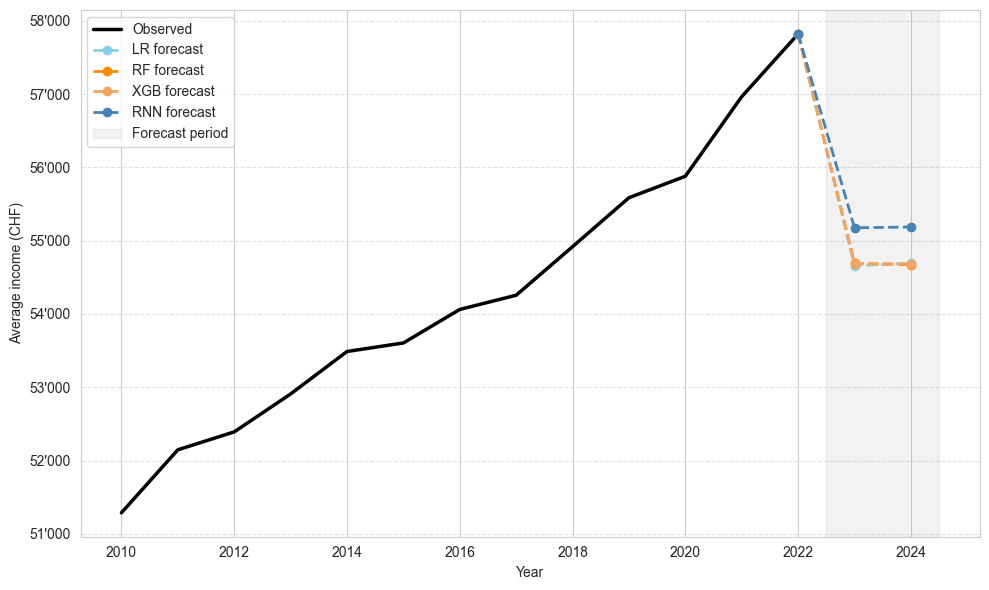

In [75]:
#Grafik mit Einkommensprognose

# Tausendertrennung
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Farben
farben = {
    'RF': '#ff8c00',     # Dark Orange
    'LR': '#87ceeb',     # Sky Blue
    'XGB': '#f4a460',    # Sandy Brown
    'RNN': '#4682b4'     # Steel Blue
}

# Plot vorbereiten
plt.figure(figsize=(10, 6))

# Tatsächliche Werte
plt.plot(df_real_avg['jahr'], df_real_avg[target],
         label='Observed', color='black', linewidth=2.5)

# Prognosen je Modell
for modell in ['LR', 'RF', 'XGB', 'RNN']:
    y_vals = df_zukunft_mittel[modell].tolist()
    x_vals = df_zukunft_mittel['Jahr'].tolist()

    last_real = df_real_avg[df_real_avg['jahr'] == 2022][target].values[0]
    x_full = [2022] + x_vals
    y_full = [last_real] + y_vals

    plt.plot(x_full, y_full, '--o',
             label=f'{modell} forecast',
             color=farben[modell],
             linewidth=2,
             markersize=6)

# Prognosezeitraum schattieren
plt.axvspan(2022.5, 2024.5, color='grey', alpha=0.1, label='Forecast period')

# Achsenbeschriftungen
plt.xlabel('Year')
plt.ylabel('Average income (CHF)')
plt.gca().yaxis.set_major_formatter(FuncFormatter(format_thousands))

# Raster, Legende, Layout
plt.grid(True, axis='y', linestyle='--', alpha=0.6)
plt.legend()
plt.tight_layout()

# Speichern & Anzeigen
plt.savefig("prognose_gesamt_basis_modelle.png", dpi=300)
plt.show()

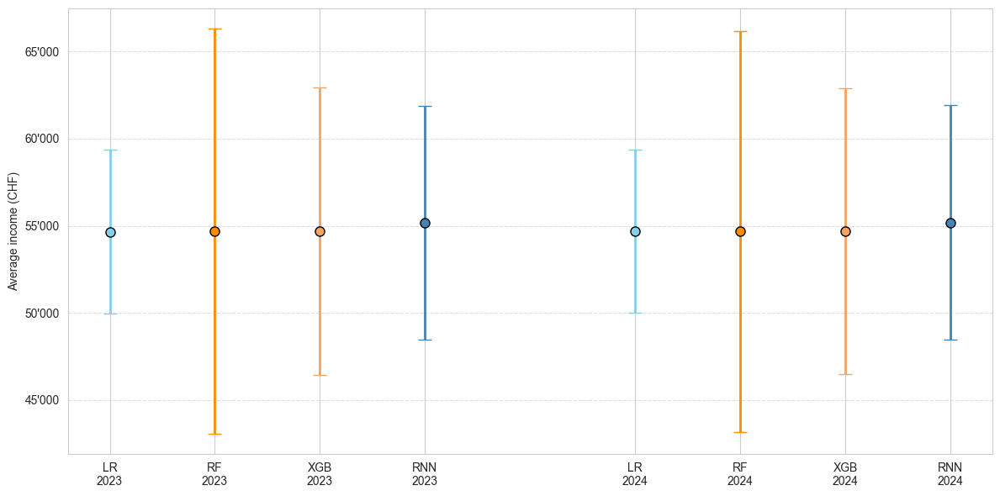

In [76]:
#Grafik mit Einkommensprognose und Schätzunsicherheit

# Tausenderformat
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Modelle und Farben
modelle = ['LR', 'RF', 'XGB', 'RNN']
farben = {
    'RF': '#ff8c00',     # Dark Orange
    'LR': '#87ceeb',     # Sky Blue
    'XGB': '#f4a460',    # Goldenrod
    'RNN': '#4682b4'     # Steel Blue
}
jahre = [2023, 2024]

# X-Achse vorbereiten
x_vals = []
x_labels = []
pos = 0
positionen = {}

for jahr in jahre:
    for modell in modelle:
        label = f"{modell}\n{jahr}"
        x_vals.append(pos)
        x_labels.append(label)
        positionen[(jahr, modell)] = pos
        pos += 1
    pos += 1  # Abstand zwischen den Jahren

# Plot
plt.figure(figsize=(12, 6))

for jahr in jahre:
    for modell in modelle:
        x = positionen[(jahr, modell)]
        y = df_zukunft_mittel.loc[df_zukunft_mittel['Jahr'] == jahr, modell].values[0]
        std = df_zukunft_mittel.loc[df_zukunft_mittel['Jahr'] == jahr, f"{modell}_std"].values[0]
        ci95 = 1.96 * std

        plt.errorbar(x, y, yerr=ci95,
                     fmt='o', capsize=6,
                     color=farben[modell], ecolor=farben[modell],
                     markersize=8, elinewidth=2, markeredgecolor='black')

# Achsenformatierung
plt.xticks(x_vals, x_labels)
plt.ylabel("Average income (CHF)")  # englische Version
plt.gca().yaxis.set_major_formatter(FuncFormatter(format_thousands))
plt.grid(True, axis='y', linestyle='--', alpha=0.6)

# Kein Titel
plt.tight_layout()
plt.savefig("prognose_2324_basis_modelle.png", dpi=300)
plt.show()

In [ ]:
#Feature Importance

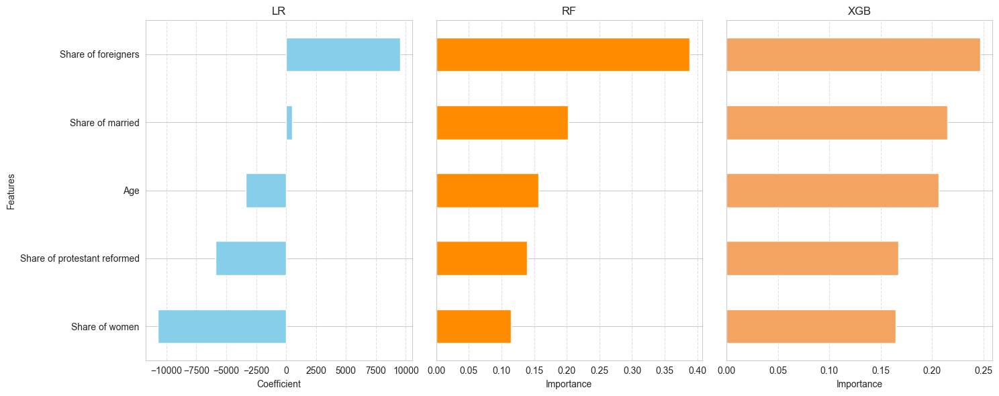

In [77]:
#Grafik mit Feature Koeffizienten/Importance

# Wiederverwendbares Feature-Set
features = ['durchschnitt_alter', 'anteil_frauen', 'anteil_verheiratet',
            'anteil_ev_ref', 'anteil_auslaender']

feature_labels = {
    'durchschnitt_alter': 'Age',
    'anteil_frauen': 'Share of women',
    'anteil_verheiratet': 'Share of married',
    'anteil_ev_ref': 'Share of protestant reformed',
    'anteil_auslaender': 'Share of foreigners'
}

# Feature Importances berechnen
lr_importance = pd.Series(lr.coef_, index=features)
rf_importance = pd.Series(rf.feature_importances_, index=features)
xgb_importance = pd.Series(xgb.feature_importances_, index=features)

#Englische Labels setzen
lr_importance.index = lr_importance.index.to_series().map(feature_labels)
rf_importance.index = rf_importance.index.to_series().map(feature_labels)
xgb_importance.index = xgb_importance.index.to_series().map(feature_labels)

# Gemeinsame Grafik mit Subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 6), sharey=True)

# Farben
farben = {
    'LR': '#87ceeb',     # Sky Blue
    'RF': '#ff8c00',     # Dark Orange
    'XGB': '#f4a460'     # Sandy Brown
}

# Plot für LR
lr_importance.sort_values().plot(kind='barh', color=farben['LR'], ax=axes[0])
axes[0].set_xlabel('Coefficient')
axes[0].set_title('LR', fontsize=12)

# Plot für RF
rf_importance.sort_values().plot(kind='barh', color=farben['RF'], ax=axes[1])
axes[1].set_xlabel('Importance')
axes[1].set_title('RF', fontsize=12)

# Plot für XGB
xgb_importance.sort_values().plot(kind='barh', color=farben['XGB'], ax=axes[2])
axes[2].set_xlabel('Importance')
axes[2].set_title('XGB', fontsize=12)

# Gemeinsames Layout
for ax in axes:
    ax.grid(True, axis='x', linestyle='--', alpha=0.6)
    ax.set_ylabel('')  # y-Achsentitel entfernen (nur bei erstem sinnvoll)

axes[0].set_ylabel('Features')  # nur beim ersten Plot sinnvoll
plt.tight_layout()
plt.savefig("feature_importance_alle_modelle.png", dpi=300)
plt.show()

In [ ]:
#Permuation Importance

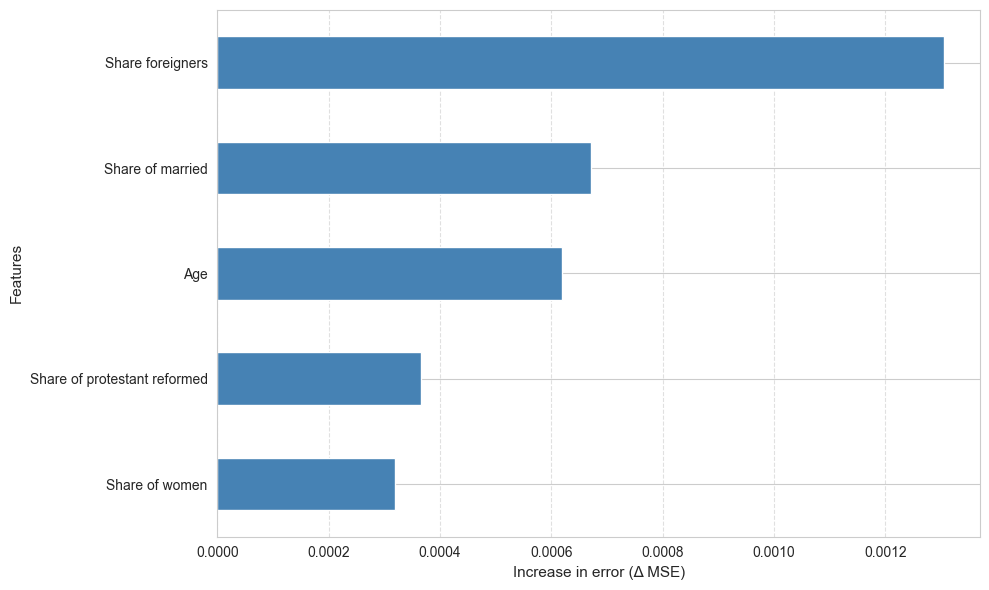

In [78]:
#Grafik der Permutations Importance

# Score-Funktion: negative MSE auf skaliertem Datensatz
def score_func(X):
    y_pred = model_rnn.predict(X, verbose=0)
    return -mean_squared_error(y_rnn, y_pred)

# Basis-Score (auf echten Trainingsdaten)
base_score = score_func(X_rnn)

# Permutation Importance
results = {}
for i, feature in enumerate(features_rnn):
    X_permuted = X_rnn.copy()
    np.random.shuffle(X_permuted[:, :, i])  # Feature i permutieren (über alle Zeitpunkte und Zellen)
    permuted_score = score_func(X_permuted)
    results[feature] = base_score - permuted_score

# Feature-Namen ins Englische übersetzen (falls nötig)
feature_labels_rnn = {
    'durchschnitt_alter': 'Age',
    'anteil_frauen': 'Share of women',
    'anteil_verheiratet': 'Share of married',
    'anteil_ev_ref': 'Share of protestant reformed',
    'anteil_auslaender': 'Share foreigners'
}

# Mapping anwenden (optional, falls nötig)
imp_series = pd.Series(results)
imp_series.index = imp_series.index.to_series().map(feature_labels_rnn)
imp_series = imp_series.sort_values()

# Plot
plt.figure(figsize=(10, 6))
imp_series.plot(kind='barh', color='#4682b4')

# Achsenbeschriftung & Formatierung
plt.xlabel('Increase in error (Δ MSE)', fontsize=11)
plt.ylabel('Features', fontsize=11)
plt.grid(True, axis='x', linestyle='--', alpha=0.6)

# Kein Titel
plt.tight_layout()
plt.savefig("feature_importance_rnn.png", dpi=300)
plt.show()

In [ ]:
#Weiterentwicklung Klassische Modelle

In [ ]:
#Grundmodelle nochmals trainieren

In [79]:
lr_stat = LinearRegression().fit(X_train_classic, y_train_classic)
rf_stat = RandomForestRegressor(random_state=0).fit(X_train_classic, y_train_classic)
xgb_stat = XGBRegressor(random_state=0).fit(X_train_classic, y_train_classic)

In [ ]:
#Modell mit Jahresvariable

In [80]:
#Jahr als feature ergänzen
features_time = features_all + ['jahr']

In [81]:
#Trainingsdatensatz mit Jahr definieren
df_train = df_analyse[df_analyse['jahr'] <= 2021].dropna(subset=features_time + [target])
X_train_time = df_train[features_time]
y_train_time = df_train[target]

In [82]:
#Modelltraining mit Jahr
lr_time = LinearRegression().fit(X_train_time, y_train_time)
rf_time = RandomForestRegressor(random_state=0).fit(X_train_time, y_train_time)
xgb_time = XGBRegressor(random_state=0).fit(X_train_time, y_train_time)

In [ ]:
#Modell mit Lag-Features

In [83]:
#Datensatz sortieren
df_analyse = df_analyse.sort_values(['cell_id', 'jahr'])

# Liste der erklärenden Variablen, für die du Lags willst
lag_vars = ['anteil_frauen', 'anteil_verheiratet', 'anteil_auslaender', 'anteil_ev_ref']

# Lag-1 pro Zelle berechnen
for var in lag_vars:
    df_analyse[f'{var}_lag1'] = df_analyse.groupby('cell_id')[var].shift(1)

In [84]:
#Lag-Variablen als Feature ergänzen
features_lags = features_all + ['jahr'] + [f'{var}_lag1' for var in lag_vars]

In [85]:
#Trainingsdatensatz mit Lag-Variablen ergänzen
df_train_lags = df_analyse[(df_analyse['jahr'] >= 2011) & (df_analyse['jahr'] <= 2021)].dropna(subset=features_lags + [target])
X_train_lags = df_train_lags[features_lags]
y_train_lags = df_train_lags[target]

In [86]:
#Modelltraining mit Jahr
lr_lags = LinearRegression().fit(X_train_lags, y_train_lags)
rf_lags = RandomForestRegressor(random_state=0).fit(X_train_lags, y_train_lags)
xgb_lags = XGBRegressor(random_state=0).fit(X_train_lags, y_train_lags)

In [ ]:
#Basis-Modell und neues Modell vergleichen

In [87]:
# Reale Testdaten für 2022
df_test_2022 = df_analyse[df_analyse['jahr'] == 2022].dropna().copy()

# Zielvariable
y_test = df_test_2022['durchschnitt_einkommen']

In [88]:
# Für statische Modelle
X_test_stat = df_test_2022[features_all]

# Für Modelle mit Jahr
X_test_jahr = df_test_2022[features_time]  # z. B. features_all + ['jahr_norm']

# Für Modelle mit Lags
X_test_lags = df_test_2022[features_lags]  # z. B. features_all + ['jahr_norm'] + lag-Variablen

In [89]:
#Lineare Modelle anwenden
y_pred_stat_lr = lr_stat.predict(X_test_stat)
y_pred_jahr_lr = lr_time.predict(X_test_jahr)
y_pred_lags_lr = lr_lags.predict(X_test_lags)

In [90]:
#Random Forest Modelle anwenden
y_pred_stat_rf = rf_stat.predict(X_test_stat)
y_pred_jahr_rf = rf_time.predict(X_test_jahr)
y_pred_lags_rf = rf_lags.predict(X_test_lags)

In [91]:
#Gradient Boosting Modelle anwenden
y_pred_stat_xgb = xgb_stat.predict(X_test_stat)
y_pred_jahr_xgb = xgb_time.predict(X_test_jahr)
y_pred_lags_xgb = xgb_lags.predict(X_test_lags)

In [92]:
#Performance metrics berechnen (LR)

def get_mae_rmse(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return mae, rmse

mae_stat, rmse_stat = get_mae_rmse(y_test, y_pred_stat_lr)
mae_jahr, rmse_jahr = get_mae_rmse(y_test, y_pred_jahr_lr)
mae_lags, rmse_lags = get_mae_rmse(y_test, y_pred_lags_lr)

# Ergebnis-DataFrame
df_lr_eval_2022 = pd.DataFrame({
    'Modell': ['LR statisch', 'LR mit Jahr', 'LR mit Lags'],
    'MAE': [mae_stat, mae_jahr, mae_lags],
    'RMSE': [rmse_stat, rmse_jahr, rmse_lags]
})

print(df_lr_eval_2022.round(2))

        Modell      MAE      RMSE
0  LR statisch  9960.38  12745.08
1  LR mit Jahr  9558.21  12294.09
2  LR mit Lags  9530.71  12259.58


In [93]:
#Performance metrics berechnen (RF)

def get_mae_rmse(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return mae, rmse

mae_stat, rmse_stat = get_mae_rmse(y_test, y_pred_stat_rf)
mae_jahr, rmse_jahr = get_mae_rmse(y_test, y_pred_jahr_rf)
mae_lags, rmse_lags = get_mae_rmse(y_test, y_pred_lags_rf)

# Ergebnis-DataFrame
df_rf_eval_2022 = pd.DataFrame({
    'Modell': ['RF statisch', 'RF mit Jahr', 'RF mit Lags'],
    'MAE': [mae_stat, mae_jahr, mae_lags],
    'RMSE': [rmse_stat, rmse_jahr, rmse_lags]
})

print(df_rf_eval_2022.round(2))

        Modell       MAE      RMSE
0  RF statisch  10271.43  13158.90
1  RF mit Jahr   9522.78  12254.32
2  RF mit Lags   9355.01  12028.86


In [94]:
#Performance metrics berechnen (XGB)
def get_mae_rmse(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    return mae, rmse

mae_stat, rmse_stat = get_mae_rmse(y_test, y_pred_stat_xgb)
mae_jahr, rmse_jahr = get_mae_rmse(y_test, y_pred_jahr_xgb)
mae_lags, rmse_lags = get_mae_rmse(y_test, y_pred_lags_xgb)

# Ergebnis-DataFrame
df_xgb_eval_2022 = pd.DataFrame({
    'Modell': ['XGB statisch', 'XGB mit Jahr', 'XGB mit Lags'],
    'MAE': [mae_stat, mae_jahr, mae_lags],
    'RMSE': [rmse_stat, rmse_jahr, rmse_lags]
})

print(df_xgb_eval_2022.round(2))

         Modell      MAE      RMSE
0  XGB statisch  9775.31  12493.51
1  XGB mit Jahr  9327.49  12025.49
2  XGB mit Lags  9303.70  11995.70


In [95]:
# Prognosedaten für 2023 und 2024 erstellen
df_future = df_analyse[df_analyse['jahr'].isin([2023, 2024])].dropna(subset=features_all)

In [96]:
#Prognose Basismodell XGB
X_future_stat = df_future[df_future['jahr'].isin([2023, 2024])][features_all]
df_future['XGB_statisch'] = xgb.predict(X_future_stat)

In [97]:
#Prognose Modell mit Jahr XGB
X_future_jahr = df_future[df_future['jahr'].isin([2023, 2024])][features_time]
df_future['XGB_mit_jahr'] = xgb_time.predict(X_future_jahr)

In [98]:
# Prognosedaten für 2023 und 2024 mit Lags
df_future_lags = df_analyse[df_analyse['jahr'].isin([2023, 2024])].dropna(subset=features_lags)

In [99]:
#Prognose Modelle mit Jahr und Lags
X_future_lags = df_future_lags[df_future_lags['jahr'].isin([2023, 2024])][features_lags]
df_future_lags['XGB_mit_lags'] = xgb_lags.predict(X_future_lags)

In [100]:
#Mean der Prognosen berechnen
df_xgb_stat = df_future.groupby('jahr')['XGB_statisch'].mean().reset_index()
df_xgb_jahr = df_future.groupby('jahr')['XGB_mit_jahr'].mean().reset_index()
df_xgb_lags = df_future_lags.groupby('jahr')['XGB_mit_lags'].mean().reset_index()

In [101]:
#Reales Durchschnitseinkommen berechnen
df_real_avg = df_analyse[df_analyse['jahr'] <= 2022].groupby('jahr')['durchschnitt_einkommen'].mean().reset_index()
last_real = df_real_avg[df_real_avg['jahr'] == 2022]['durchschnitt_einkommen'].values[0]

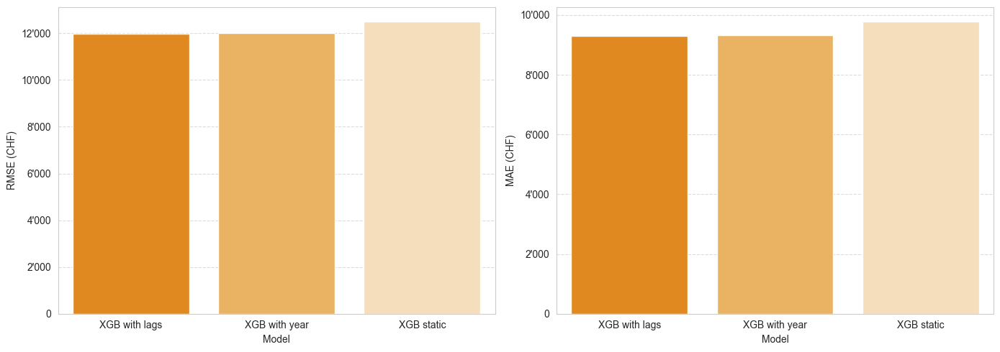

In [102]:
#Grafik mit Performance Metrics der XGB-Modelle

# Tausenderformatierer
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Modellnamen ins Englische übersetzen
modell_mapping = {
    'XGB statisch': 'XGB static',
    'XGB mit Jahr': 'XGB with year',
    'XGB mit Lags': 'XGB with lags'
}

df_xgb_eval_2022['Modell'] = df_xgb_eval_2022['Modell'].replace(modell_mapping)

farben_xgb = {
    'XGB static': '#ffe0b2',
    'XGB with year': '#ffb74d',
    'XGB with lags': '#ff8c00'
}

# Daten sortieren
df_rmse = df_xgb_eval_2022.sort_values('RMSE')
df_mae = df_xgb_eval_2022.sort_values('MAE')

# Figure mit zwei Subplots nebeneinander
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5), sharey=False)

# RMSE
sns.barplot(
    data=df_rmse,
    x='Modell',
    y='RMSE',
    hue='Modell',
    palette=farben_xgb,
    legend=False,
    ax=ax1
)
ax1.set_xlabel("Model")
ax1.set_ylabel("RMSE (CHF)")
ax1.yaxis.set_major_formatter(FuncFormatter(format_thousands))
ax1.set_ylim(bottom=0)
ax1.grid(axis='y', linestyle='--', alpha=0.7)

# MAE
sns.barplot(
    data=df_mae,
    x='Modell',
    y='MAE',
    hue='Modell',
    palette=farben_xgb,
    legend=False,
    ax=ax2
)
ax2.set_xlabel("Model")
ax2.set_ylabel("MAE (CHF)")
ax2.yaxis.set_major_formatter(FuncFormatter(format_thousands))
ax2.set_ylim(bottom=0)
ax2.grid(axis='y', linestyle='--', alpha=0.7)

# Layout und Export
plt.tight_layout()
plt.savefig("modellvergleich_rmse_mae_xgb.png", dpi=300)
plt.show()

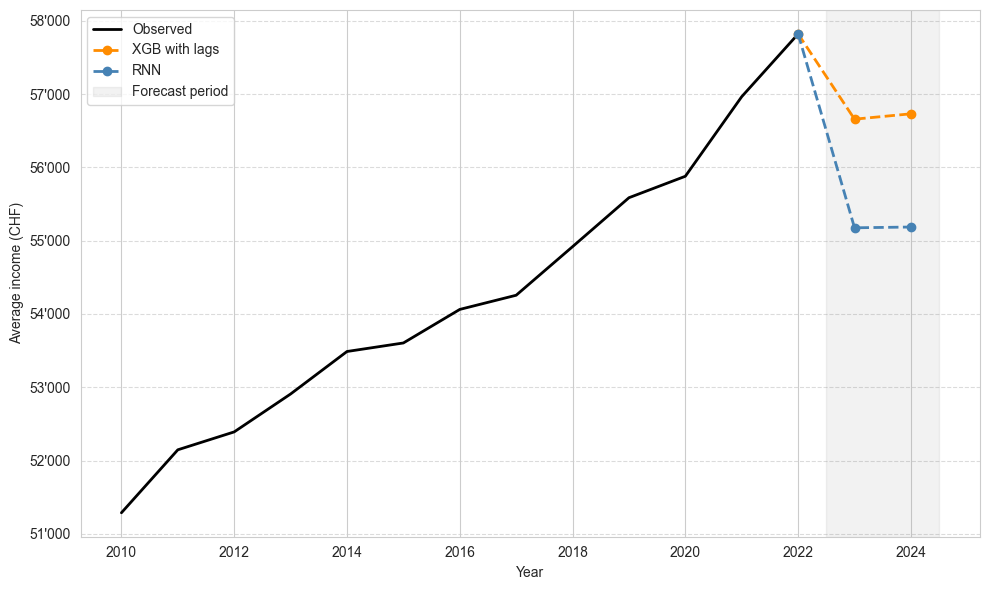

In [103]:
#Grafik mit Einkommensprognose RNN/XGB

# Farben (englische Labels!)
farben_modelle = {
    'XGB static': '#ffe0b2',
    'XGB with year': '#ffb74d',
    'XGB with lags': '#ff8c00',
    'RNN': '#4682b4'
}

# Formatfunktion
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Basisplot
plt.figure(figsize=(10, 6))

# Tatsächliche Werte bis 2022
plt.plot(df_real_avg['jahr'], df_real_avg['durchschnitt_einkommen'],
         label='Observed', color='black', linewidth=2)

# Letzter echter Wert
last_real = df_real_avg[df_real_avg['jahr'] == 2022]['durchschnitt_einkommen'].values[0]

# Prognoseplot-Funktion
def plot_prognose_from_df(df, spaltenname, label):
    x_vals = [2022] + df['Jahr'].tolist()
    y_vals = [last_real] + df[spaltenname].tolist()
    plt.plot(x_vals, y_vals, '--o', label=label,
             color=farben_modelle[label], linewidth=2)

# XGB (z. B. lags-Modell)
df_xgb_plot = df_xgb_lags.rename(columns={'jahr': 'Jahr'})
df_xgb_plot = df_xgb_plot.rename(columns={'XGB_mit_lags': 'XGB with lags'})
plot_prognose_from_df(df_xgb_plot, 'XGB with lags', 'XGB with lags')

# RNN
plot_prognose_from_df(df_zukunft_mittel, 'RNN', 'RNN')

# Prognosezeitraum
plt.axvspan(2022.5, 2024.5, color='grey', alpha=0.1, label='Forecast period')

# Achsen
plt.xlabel('Year')
plt.ylabel('Average income (CHF)')
plt.gca().yaxis.set_major_formatter(FuncFormatter(format_thousands))
plt.grid(True, axis='y', linestyle='--', alpha=0.7)

# Legende & Layout
plt.legend()
plt.tight_layout()
plt.savefig("prognose_gesamt_xgb_rnn.png", dpi=300)
plt.show()

In [104]:
# Standardabweichungen pro Jahr und XGB-Modell berechnen
df_xgb_lags_std = df_future_lags.groupby('jahr')['XGB_mit_lags'].std().reset_index(name='XGB mit Lags_std')
df_xgb_jahr_std = df_future.groupby('jahr')['XGB_mit_jahr'].std().reset_index(name='XGB mit Jahr_std')
df_xgb_stat_std = df_future.groupby('jahr')['XGB_statisch'].std().reset_index(name='XGB statisch_std')

In [105]:
# Mittelwerte umbenennen für Klarheit
df_xgb_lags = df_xgb_lags.rename(columns={'XGB_mit_lags': 'XGB mit Lags'})
df_xgb_jahr = df_xgb_jahr.rename(columns={'XGB_mit_jahr': 'XGB mit Jahr'})
df_xgb_stat = df_xgb_stat.rename(columns={'XGB_statisch': 'XGB statisch'})

# Zusammenführen aller Mittelwerte
df_xgb_zukunft = df_xgb_stat.merge(df_xgb_jahr, on='jahr') \
                            .merge(df_xgb_lags, on='jahr')

# Zusammenführen aller Standardabweichungen
df_xgb_zukunft = df_xgb_zukunft.merge(df_xgb_stat_std, on='jahr') \
                               .merge(df_xgb_jahr_std, on='jahr') \
                               .merge(df_xgb_lags_std, on='jahr')

# Spalte umbenennen (optional)
df_xgb_zukunft = df_xgb_zukunft.rename(columns={'jahr': 'Jahr'})

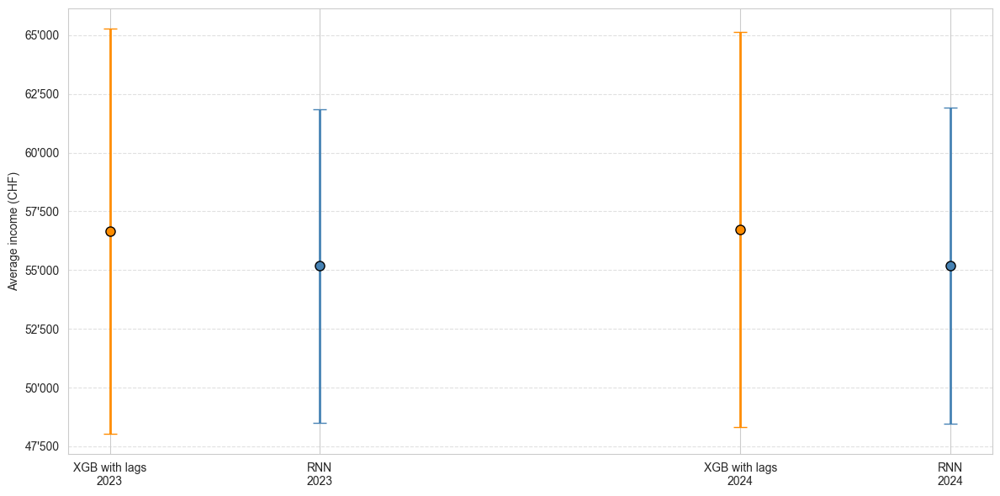

In [106]:
#Grafik mit Einkommensprognose mit Schätzunsicherheit

# Tausenderformatierer
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Modelle und Farben (Englisch)
modelle = ['XGB with lags', 'RNN']
farben = {
    'XGB with lags': '#ff8c00',
    'RNN': '#4682b4'
}
jahre = [2023, 2024]  # korrigiert

# Spaltennamen ins Englische umbenennen
df_xgb_plot = df_xgb_lags.rename(columns={
    'jahr': 'Year',
    'XGB mit Lags': 'XGB with lags'
})
df_xgb_lags_std = df_xgb_lags_std.rename(columns={
    'jahr': 'Year',
    'XGB mit Lags_std': 'XGB with lags_std'
})

# X-Achse vorbereiten
x_vals = []
x_labels = []
pos = 0
positionen = {}

for jahr in jahre:
    for modell in modelle:
        label = f"{modell}\n{jahr}"
        x_vals.append(pos)
        x_labels.append(label)
        positionen[(jahr, modell)] = pos
        pos += 1
    pos += 1  # Abstand zwischen Jahren

# Plot starten
plt.figure(figsize=(12, 6))

for jahr in jahre:
    for modell in modelle:
        x = positionen[(jahr, modell)]
        if modell == 'XGB with lags':
            y = df_xgb_plot[df_xgb_plot['Year'] == jahr]['XGB with lags'].values[0]
            std = df_xgb_lags_std[df_xgb_lags_std['Year'] == jahr]['XGB with lags_std'].values[0]
        else:  # RNN
            y = df_zukunft_mittel[df_zukunft_mittel['Jahr'] == jahr]['RNN'].values[0]
            std = df_zukunft_mittel[df_zukunft_mittel['Jahr'] == jahr]['RNN_std'].values[0]

        ci95 = 1.96 * std

        plt.errorbar(x, y, yerr=ci95,
                     fmt='o', capsize=6,
                     color=farben[modell], ecolor=farben[modell],
                     markersize=8, elinewidth=2, markeredgecolor='black')

# Achsen und Layout
plt.xticks(x_vals, x_labels, rotation=0)
for label in plt.gca().get_xticklabels():
    label.set_ha('center')

plt.ylabel("Average income (CHF)")
plt.gca().yaxis.set_major_formatter(FuncFormatter(format_thousands))
plt.grid(True, axis='y', linestyle='--', alpha=0.6)

# Kein Titel
plt.tight_layout()
plt.savefig("prognose_2324_xgb_rnn.png", dpi=300)
plt.show()

In [ ]:
#Diskussion

In [ ]:
#Prüfung out of distribution problem

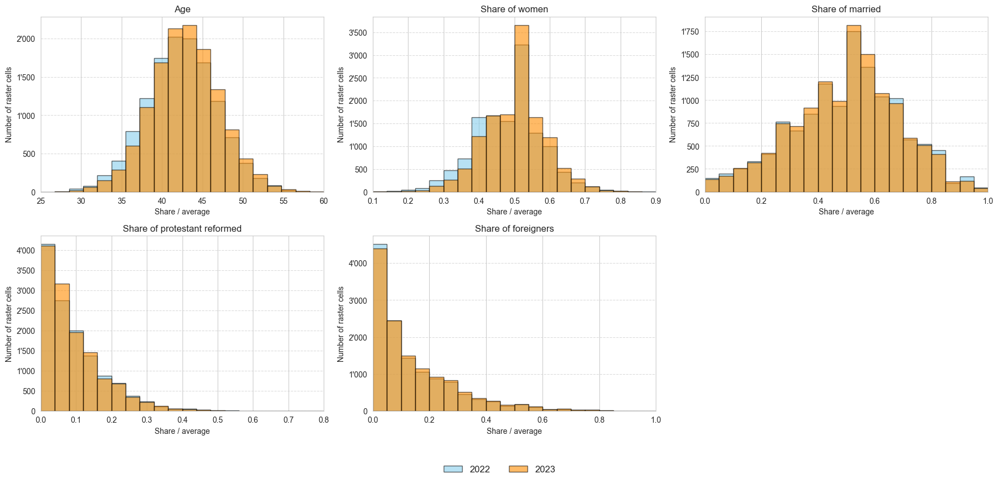

In [107]:
#Grafik mit Verteilung der Features 2022 und 2023 (OOD-Detection)

# Tausenderformatierung
def format_thousands(x, _):
    return f"{int(x):,}".replace(",", "'")

# Farben
farbe_2022 = '#87ceeb'   # Skyblue
farbe_2023 = '#ff8c00'   # Darkorange

# Stil
sns.set_style("whitegrid")

# Variablen & englische Titel
variablen = ['durchschnitt_alter', 'anteil_frauen', 'anteil_verheiratet', 'anteil_ev_ref', 'anteil_auslaender']
labels = ['Age', 'Share of women', 'Share of married', 'Share of protestant reformed', 'Share of foreigners']

# Einheitliche Bin-Grenzen pro Variable
bin_grenzen = {
    'durchschnitt_alter': np.linspace(25, 60, 21),
    'anteil_frauen': np.linspace(0.1, 0.9, 21),
    'anteil_verheiratet': np.linspace(0, 1, 21),
    'anteil_ev_ref': np.linspace(0, 0.8, 21),
    'anteil_auslaender': np.linspace(0, 1, 21)
}

# Daten vorbereiten
df_2022 = df_analyse[(df_analyse['jahr'] == 2022) & (df_analyse['durchschnitt_einkommen'].notna())]
df_2023 = df_analyse[df_analyse['jahr'] == 2023]

# Layout: 2 Zeilen, 3 Spalten
fig, axs = plt.subplots(2, 3, figsize=(18, 8))
axs = axs.flatten()

for i, (var, label) in enumerate(zip(variablen, labels)):
    ax = axs[i]

    # Feste Bins & x-Achsenbereich
    bins = bin_grenzen[var]
    ax.hist(df_2022[var].dropna(), bins=bins, alpha=0.6, label='2022',
            color=farbe_2022, edgecolor='black')
    ax.hist(df_2023[var].dropna(), bins=bins, alpha=0.6, label='2023',
            color=farbe_2023, edgecolor='black')

    ax.set_xlim(bins[0], bins[-1])
    ax.set_title(label, fontsize=12)
    ax.set_xlabel('Share / average')
    ax.set_ylabel('Number of raster cells')
    ax.grid(axis='y', linestyle='--', alpha=0.7)
    ax.yaxis.set_major_formatter(FuncFormatter(format_thousands))

# Letztes Feld (unten rechts) löschen
fig.delaxes(axs[-1])

# Legende in freie Ecke setzen
handles, labels_ = axs[0].get_legend_handles_labels()
fig.legend(handles, labels_, loc='upper center', bbox_to_anchor=(0.5, -0.03),
           ncol=2, frameon=False, fontsize=12)

# Kein Titel, sauberes Layout
plt.tight_layout()
plt.savefig("verteilung_features_gesamt_2022_2023.png", dpi=300)
plt.show()